In [1]:
from scipy.interpolate import interp1d
from utils import *
import os
from scipy.stats import t
import scipy.io as spi
import math
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from itertools import chain
from Inlier_Thresholder import Inlier_Thresholder
from stats import *

In [2]:
root = '/Users/gabrielegiusti/Desktop/Progetto_IACV/adelH/'
print(os.listdir(root))
data = [f for f in os.listdir(root) if os.path.isfile(root + f)]
data1 = spi.loadmat(root + data[3])
data2 = spi.loadmat(root + data[2])
keypts = data1['data']

['barrsmith.mat', 'physics.mat', 'oldclassicswing.mat', 'library.mat', 'bonhall.mat', 'unihouse.mat', 'elderhalla.mat', 'elderhallb.mat', 'johnsonb.mat', 'sene.mat', 'johnsona.mat', 'neem.mat', 'bonython.mat', 'napierb.mat', 'hartley.mat', 'napiera.mat', 'nese.mat', 'ladysymon.mat']


In [3]:
img1,img2=data1["img1"],data1["img2"]

outliers,models=vi.group_models(data1)["outliers"],vi.group_models(data1)["models"]

src_points = np.array(list(zip(models[0][0], models[0][1])))

dst_points = np.array(list(zip(models[0][2], models[0][3])))

In [4]:
'''
Initialization:
    In order to initialize the Forward Search algorithm we have to find a subset of our points
    completely made of inliers. To do so we can estimate the model by fitting the points with
    the LMEDS robust fitting algorithm. This method has a strong assumption that at least 50%
    of the points must be inliers.
'''

# Computation of the homography with LMEDS
H_LMEDS, mask_LMEDS = verify_LMEDS_H(src_points, dst_points)

init_pts = src_points[np.argsort(mask_LMEDS)[::-1]]

print(np.argsort(mask_LMEDS)[::-1])

47.0 inliers found
[49 48 22 21 20 19 18 17 16 15 14 13 12 11  9  8  7  6  5  4  3  2  1 23
  0 25 26 47 46 45 44 42 41 40 39 38 37 36 35 34 33 32 31 30 29 28 27 10
 43 24]


# Forward Search implementation

In [5]:
directory = '/Users/gabrielegiusti/Desktop/Progetto_IACV/adelH'

# List all files in the directory
files = os.listdir(directory)

# Filter out only the .mat files
mat_files = [file for file in files if file.endswith('.mat')]

# Load each .mat file
mat_data = {}
names=[]
for file in mat_files:
    file_path = os.path.join(directory, file)
    names.append(file)
    mat_data[file] = spi.loadmat(file_path)

50.0 inliers found


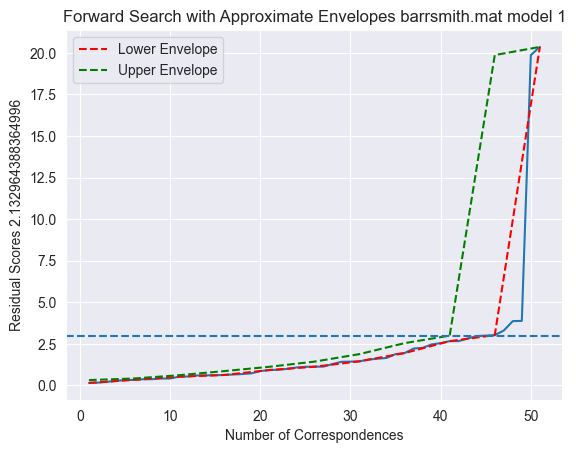

21.0 inliers found


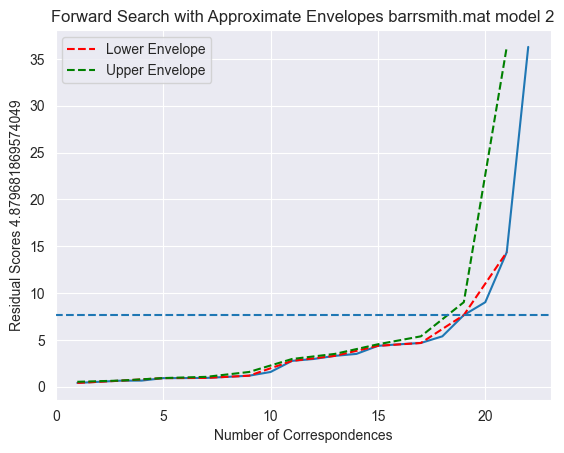

58.0 inliers found


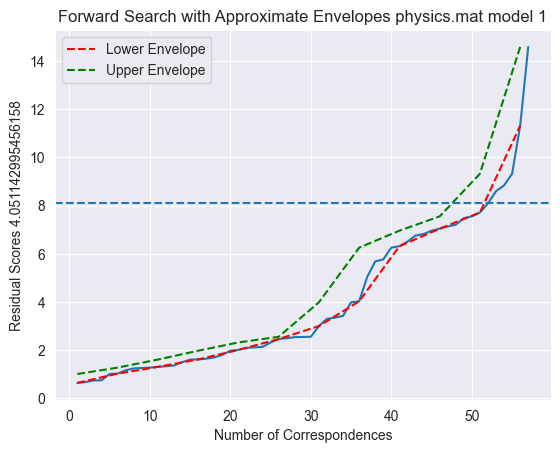

178.0 inliers found


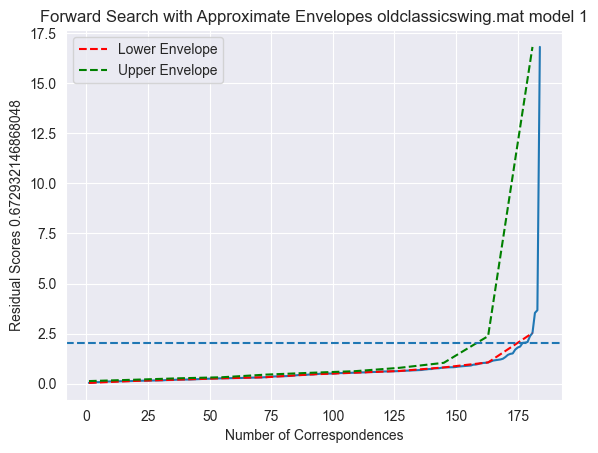

66.0 inliers found


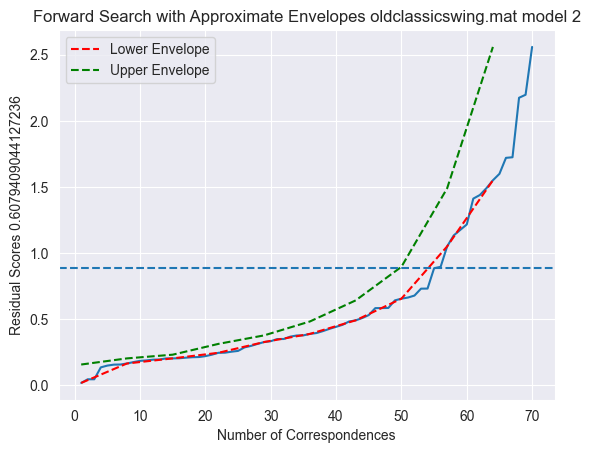

47.0 inliers found


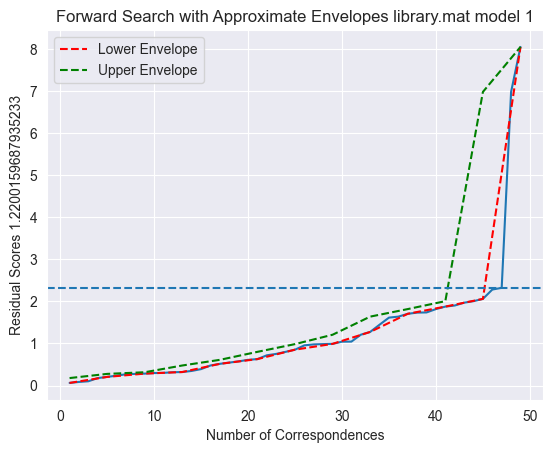

43.0 inliers found


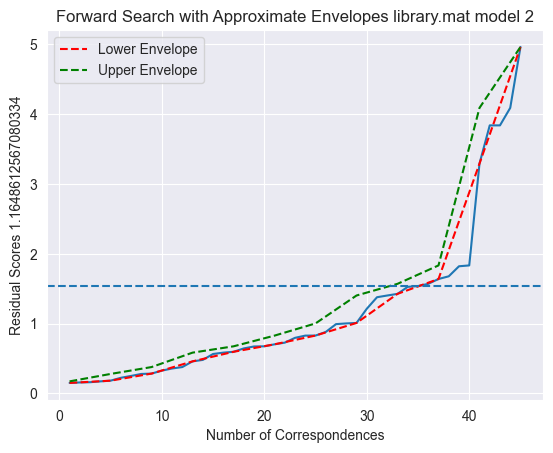

105.0 inliers found


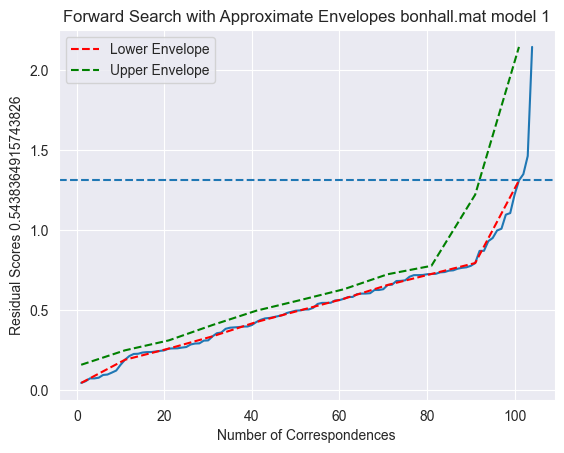

304.0 inliers found


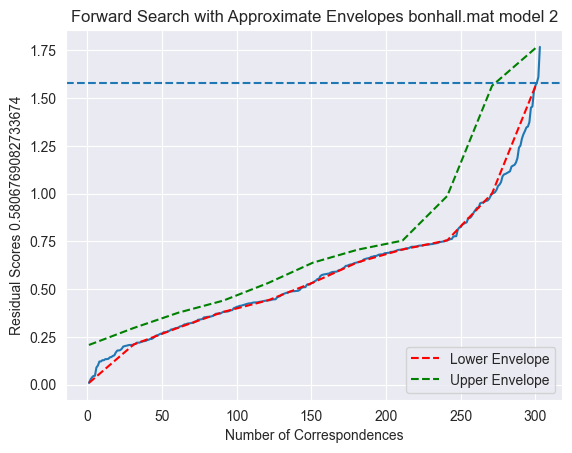

61.0 inliers found


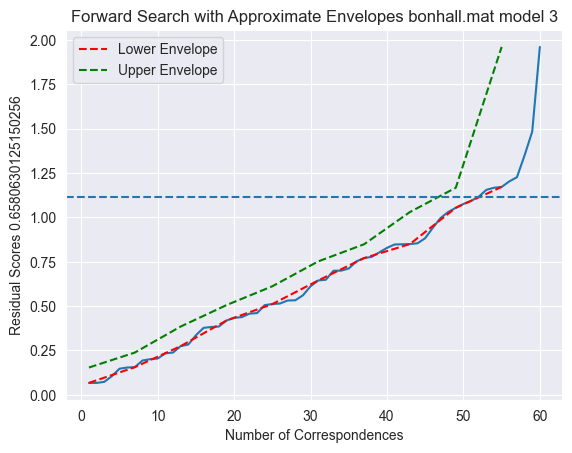

337.0 inliers found


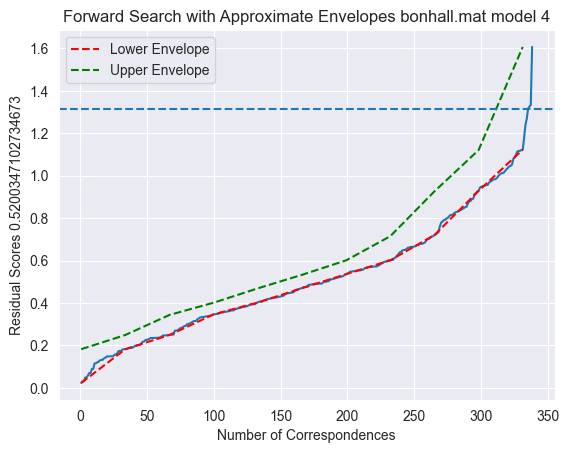

77.0 inliers found


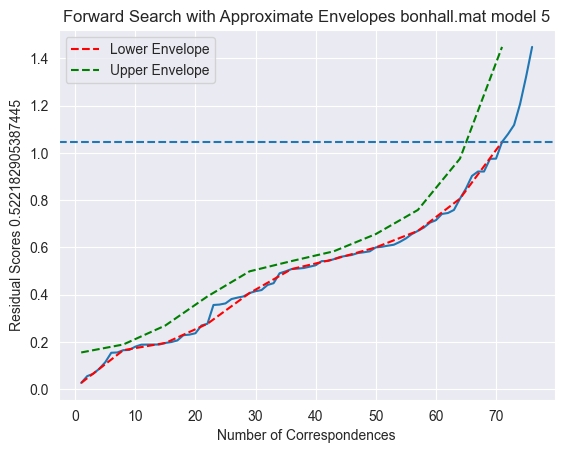

116.0 inliers found


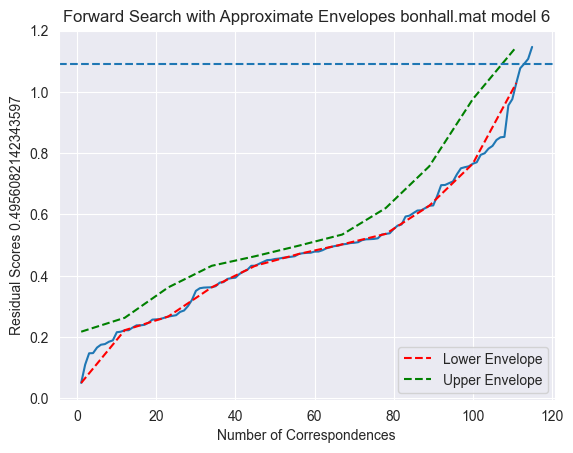

500.0 inliers found


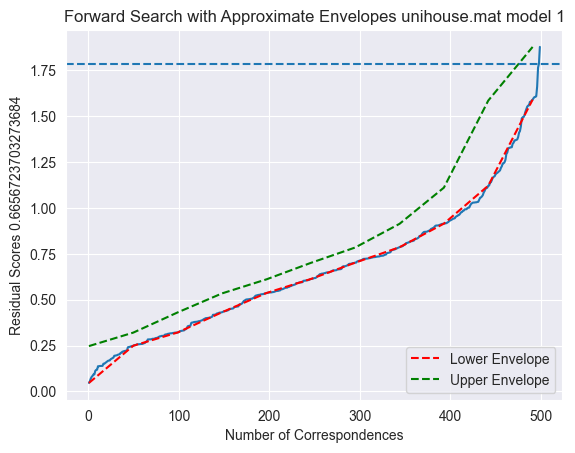

86.0 inliers found


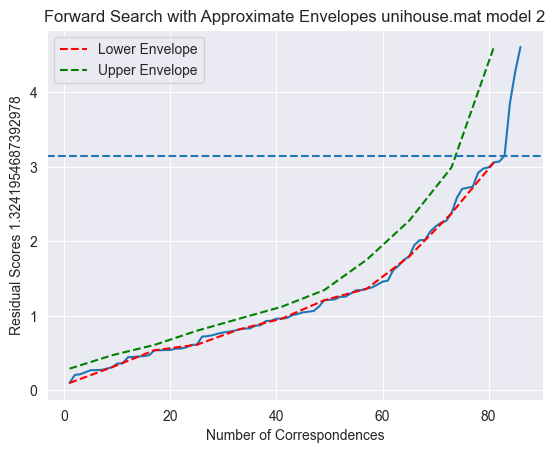

496.0 inliers found


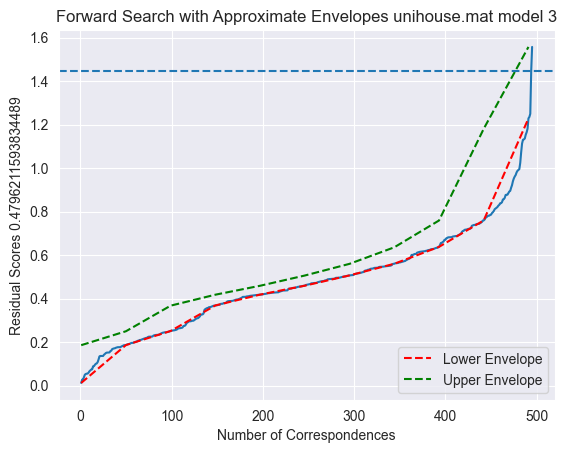

500.0 inliers found


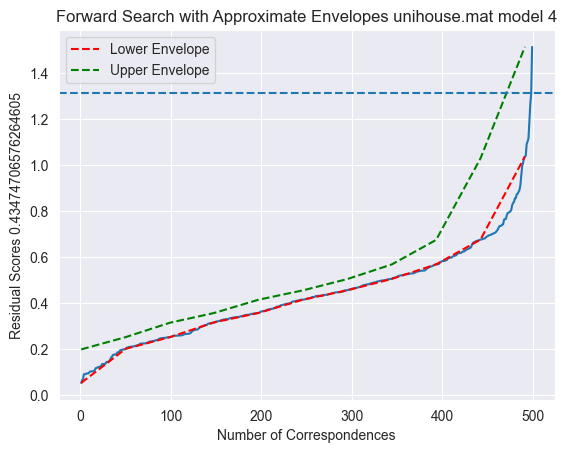

156.0 inliers found


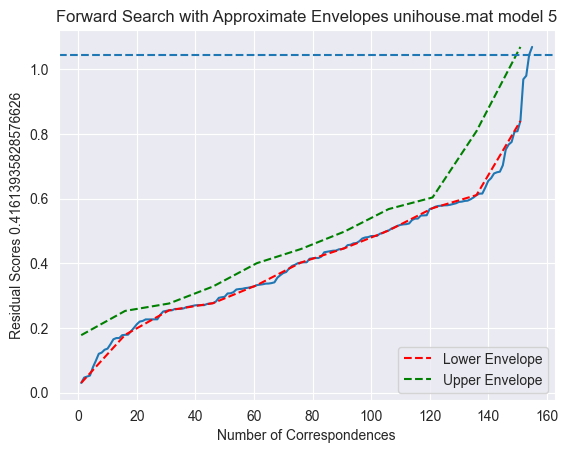

36.0 inliers found


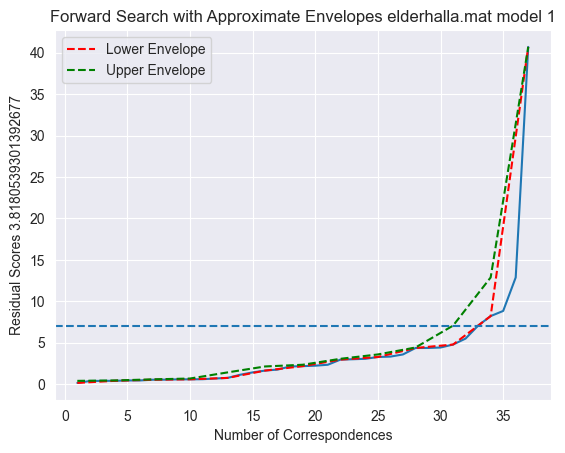

42.0 inliers found


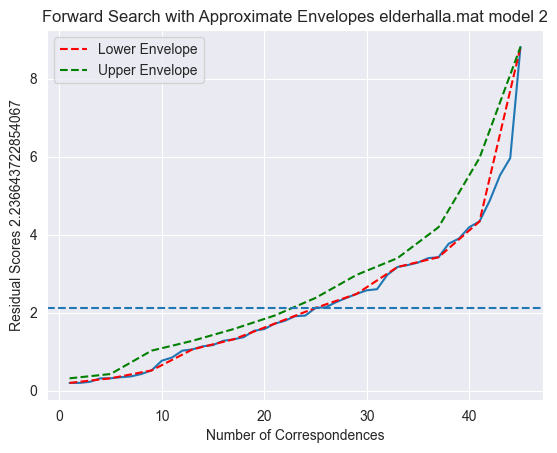

39.0 inliers found


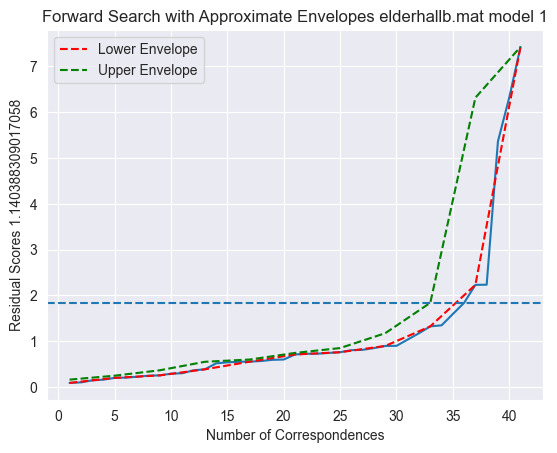

24.0 inliers found


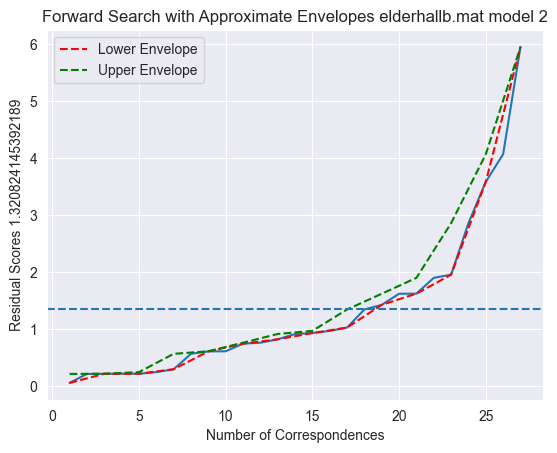

52.0 inliers found


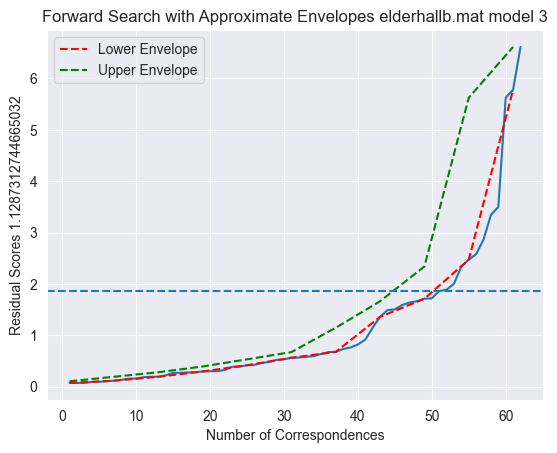

16.0 inliers found


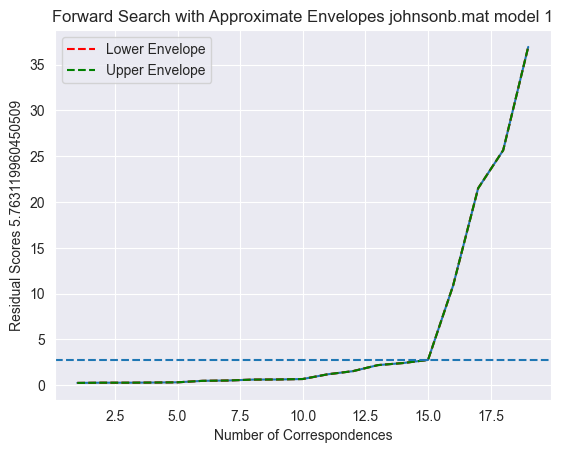

68.0 inliers found


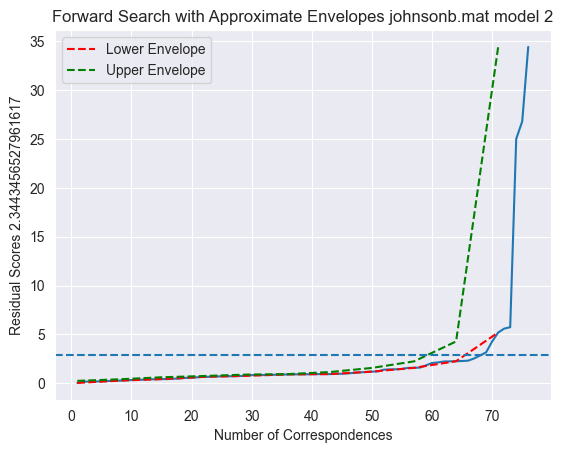

254.0 inliers found


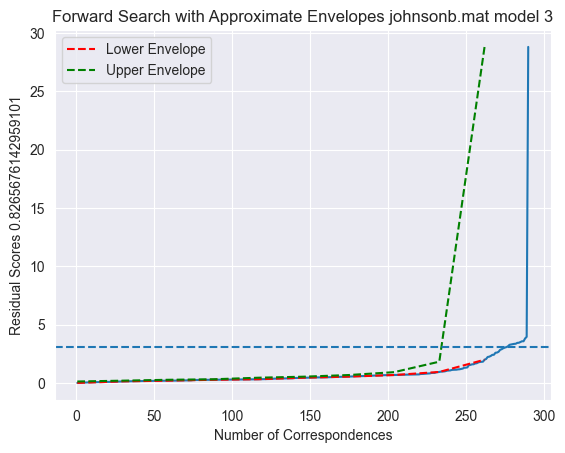

63.0 inliers found


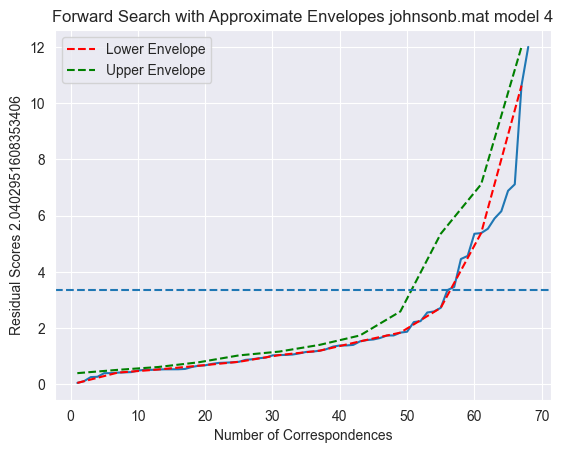

30.0 inliers found


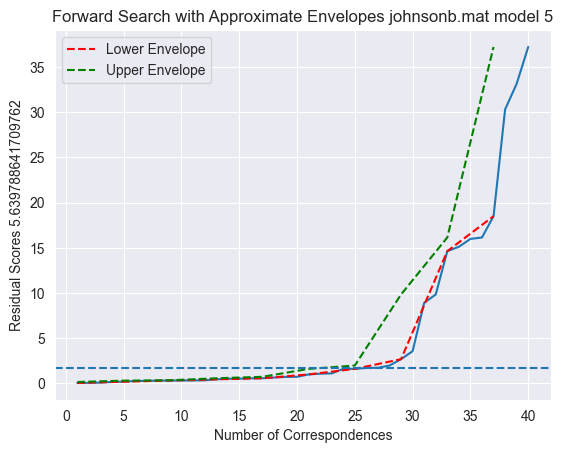

15.0 inliers found


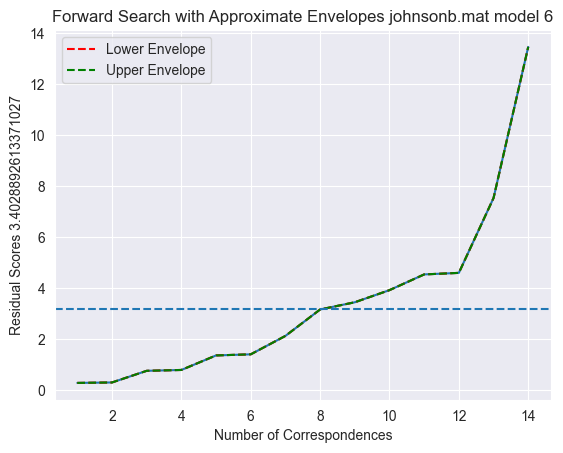

53.0 inliers found


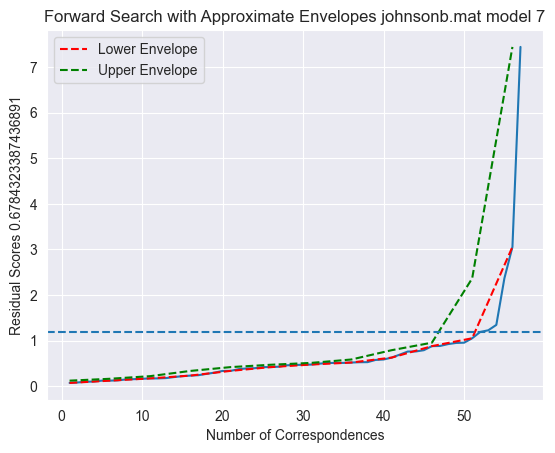

79.0 inliers found


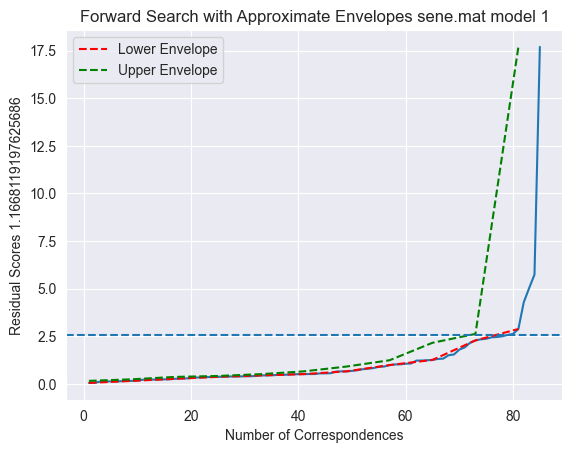

44.0 inliers found


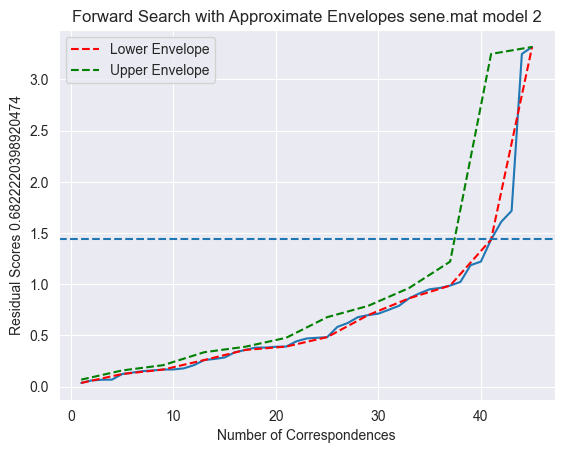

68.0 inliers found


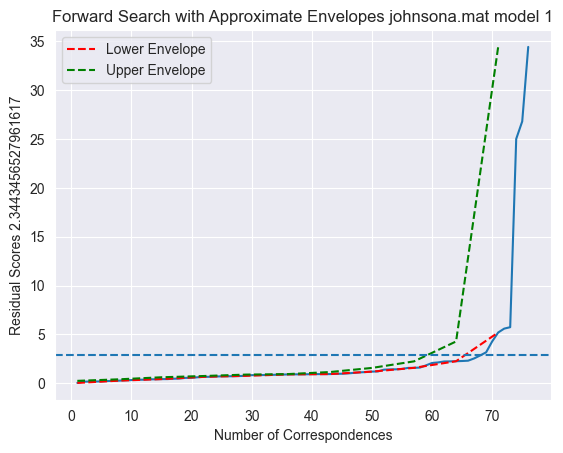

88.0 inliers found


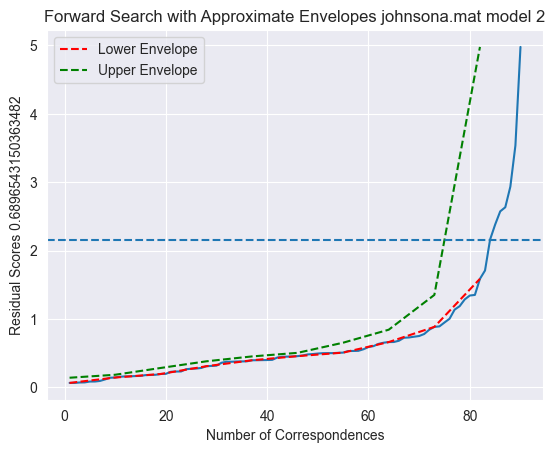

63.0 inliers found


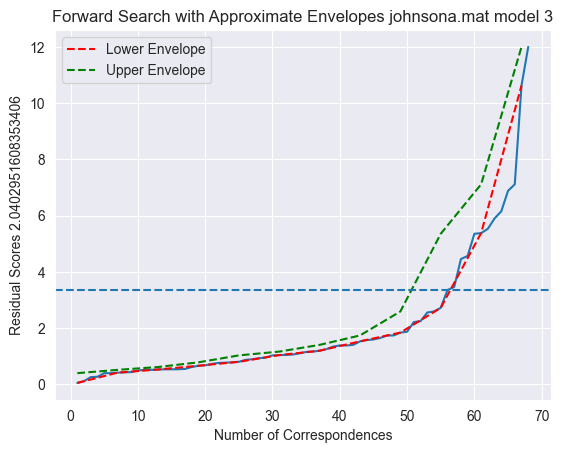

53.0 inliers found


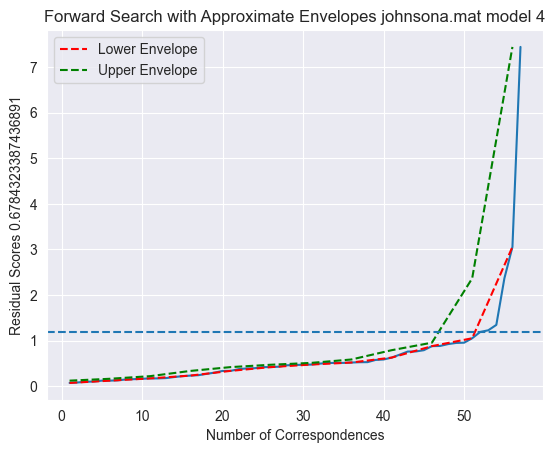

54.0 inliers found


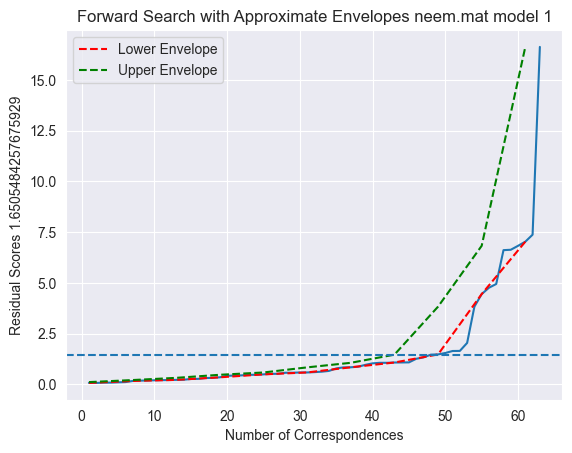

42.0 inliers found


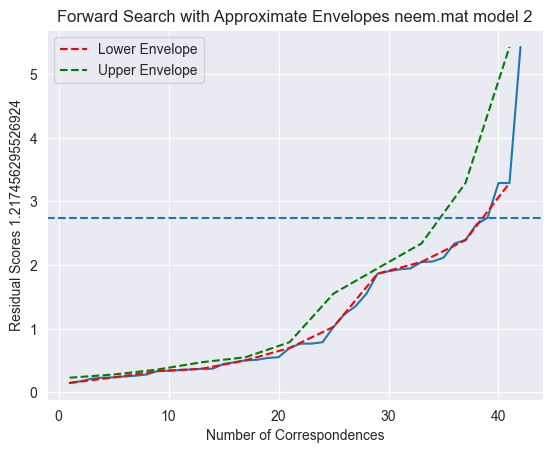

43.0 inliers found


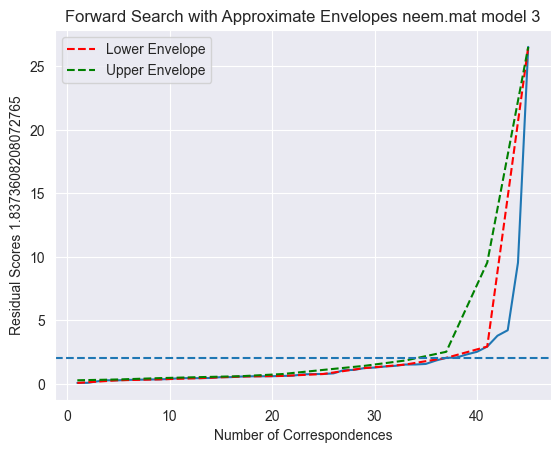

48.0 inliers found


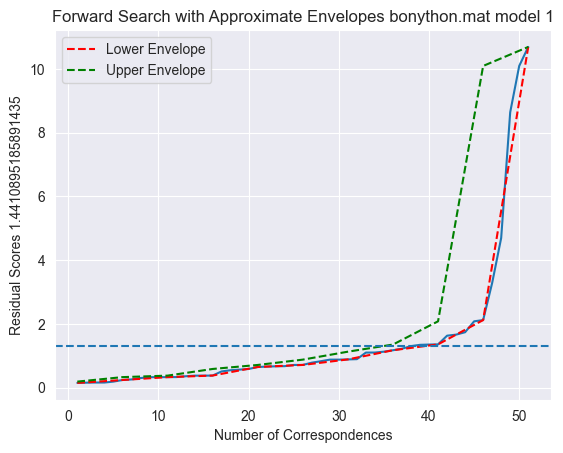

47.0 inliers found


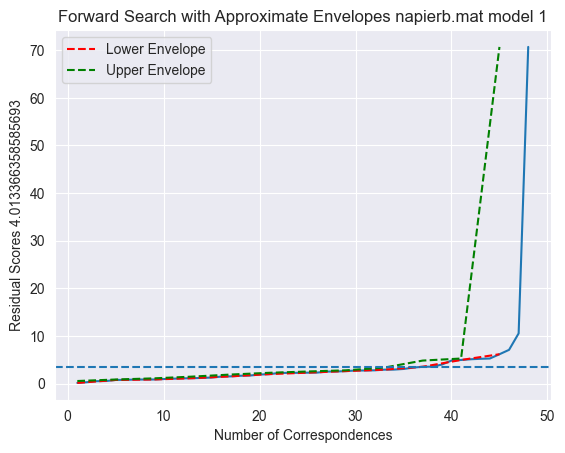

33.0 inliers found


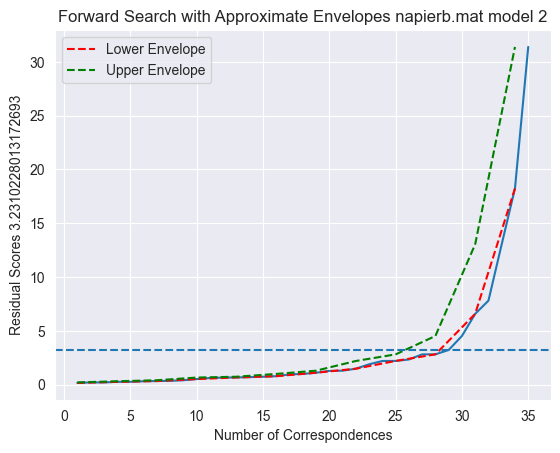

63.0 inliers found


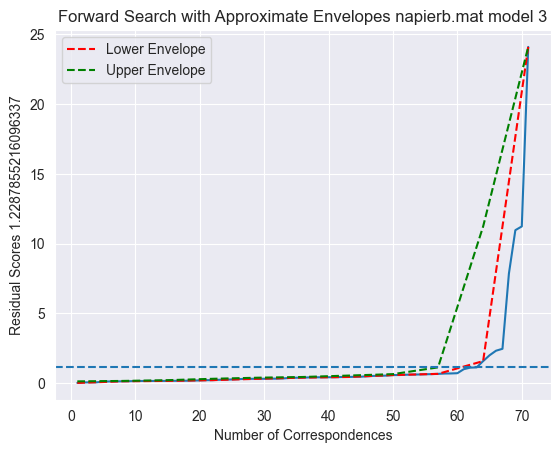

85.0 inliers found


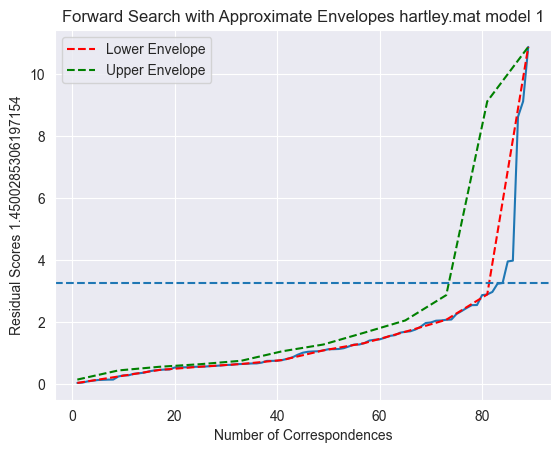

26.0 inliers found


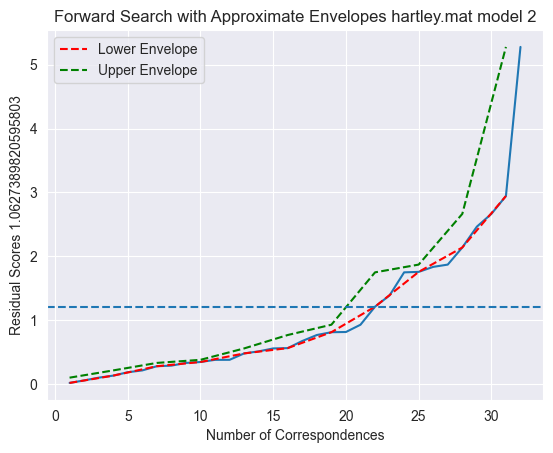

28.0 inliers found


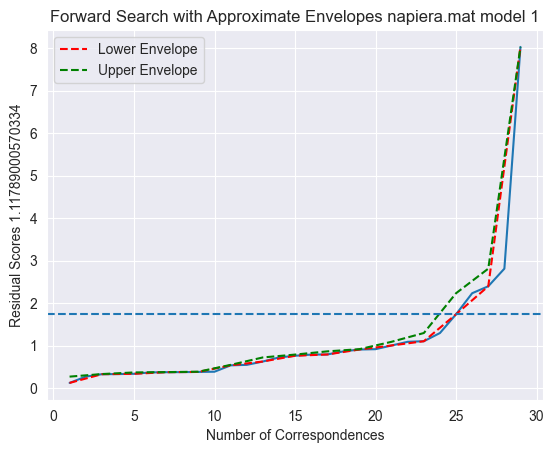

66.0 inliers found


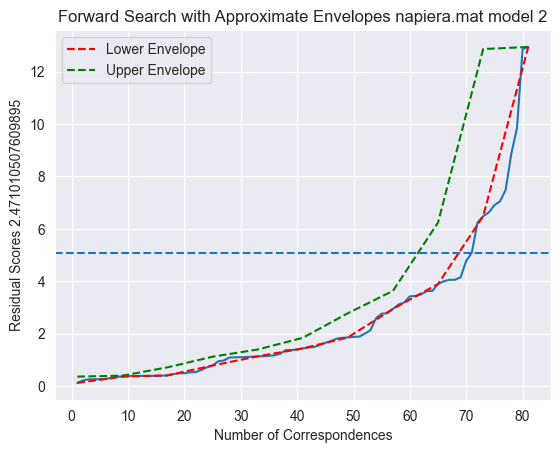

89.0 inliers found


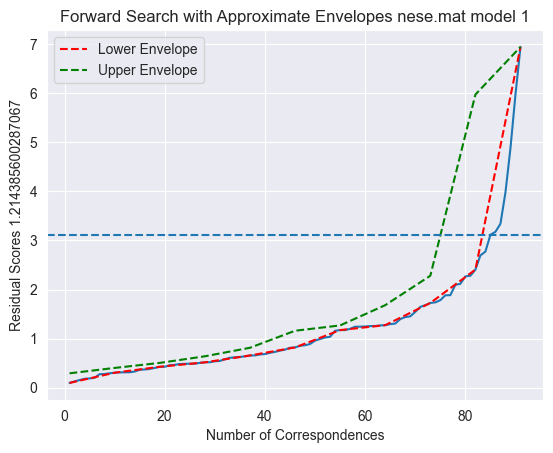

74.0 inliers found


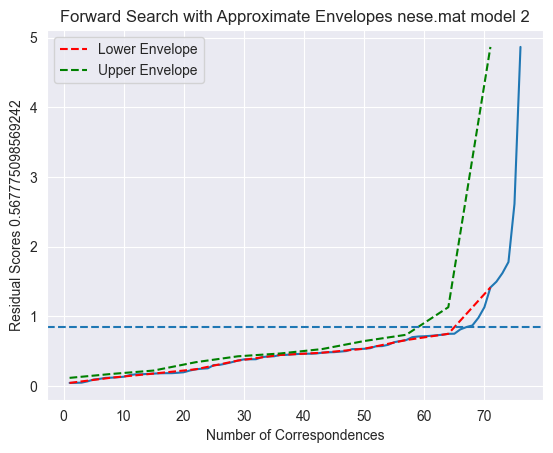

103.0 inliers found


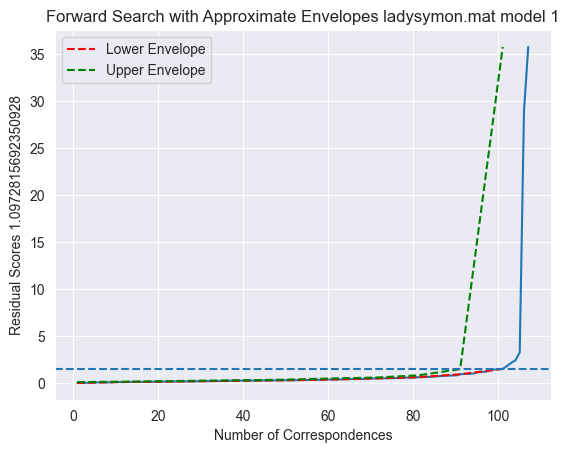

50.0 inliers found


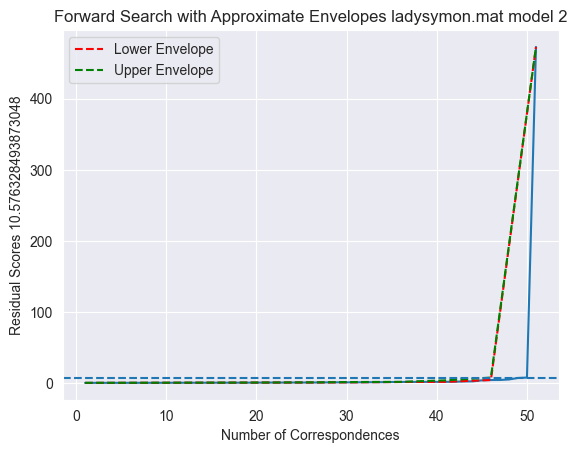

In [19]:
number_of_data_to_analyse=len(names)
thresholds = [[] for i in range(number_of_data_to_analyse)]

for i in range(number_of_data_to_analyse):

    data = mat_data[names[i]]
    thresholds[i].append(plot_forward_search(data, names[i], significance=0.8))


In [20]:
thresholds = list(chain.from_iterable(thresholds))

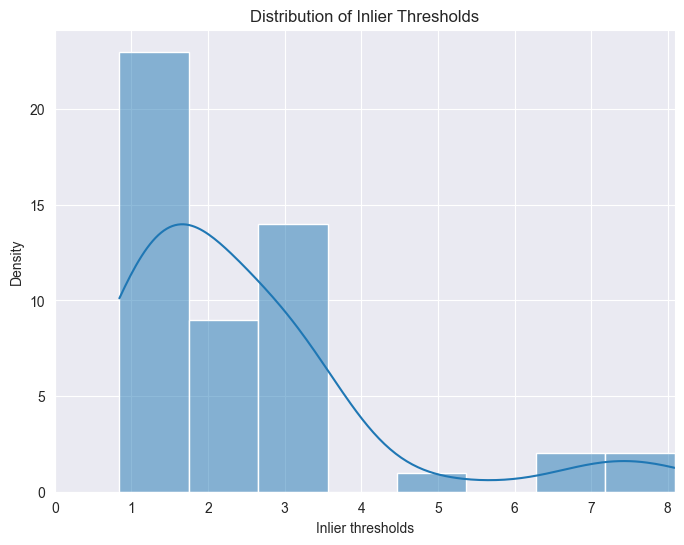

In [21]:
# Create a histogram to visualize the distribution
plt.figure(figsize=(8, 6))
sns.histplot(list(chain.from_iterable(thresholds)), bins='auto', kde=True)  # kde=True plots a kernel density estimate along with the histogram

# Label the axes and add a title
plt.xlabel("Inlier thresholds")
plt.ylabel("Density")
plt.title("Distribution of Inlier Thresholds")

plt.grid(True)
plt.xlim(0, max(max(thresholds)))  # Set limits for silhouette scores (typically between -1 and 1)

# Display the plot
plt.show()

In [22]:
errors = []
average_error = {}
for i in range(len(names)):
    data = mat_data[names[i]]
    res = compute_inliers_residual_curve(data)

    threshold = thresholds[i]
    average_errors = analyze_reprojection_error(data, threshold, method="ransac")
    print("Average reprojection errors for inliers:")
    for threshold, error in average_errors.items():
        print(f"Threshold: {threshold}, Average Reprojection Error: {error:.4f}")
        errors.append(error)

46.0 inliers found
21.0 inliers found
Average reprojection errors for inliers:
Threshold: 2.9663332233873465, Average Reprojection Error: 1.1152
Threshold: 7.638349769477379, Average Reprojection Error: 2.2087
43.0 inliers found
Average reprojection errors for inliers:
Threshold: 8.091659332066452, Average Reprojection Error: 2.8446
178.0 inliers found
49.0 inliers found
Average reprojection errors for inliers:
Threshold: 2.0491078176248183, Average Reprojection Error: 0.5124
Threshold: 0.8857474959647965, Average Reprojection Error: 0.2864
40.0 inliers found
31.0 inliers found
Average reprojection errors for inliers:
Threshold: 2.3222807588606784, Average Reprojection Error: 0.6724
Threshold: 1.5374320755437278, Average Reprojection Error: 0.6209
89.0 inliers found
263.0 inliers found
39.0 inliers found
287.0 inliers found
61.0 inliers found
91.0 inliers found
Average reprojection errors for inliers:
Threshold: 1.3121807873085718, Average Reprojection Error: 0.4633
Threshold: 1.580180

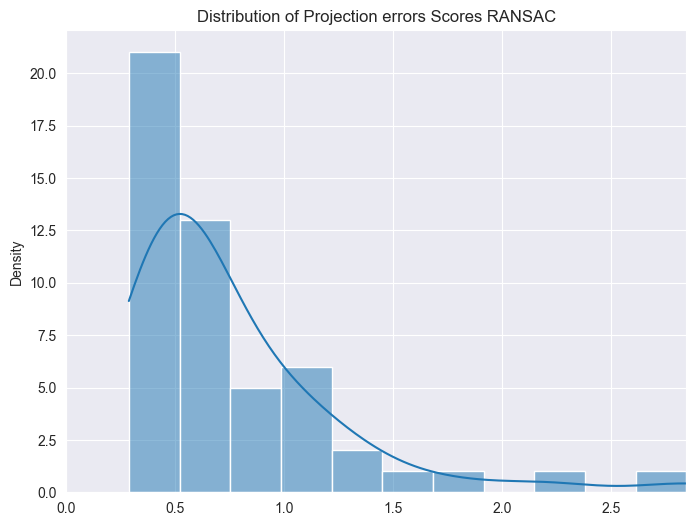

In [23]:
plt.figure(figsize=(8, 6))
sns.histplot(errors, bins='auto',
             kde=True)  # kde=True plots a kernel density estimate along with the histogram

# Label the axes and add a title
# plt.xlabel("Projection Error Average")
plt.ylabel("Density")
plt.title("Distribution of Projection errors Scores RANSAC")

plt.grid(True)
plt.xlim(0, max(errors))

# Display the plot
plt.show()

In [24]:
directory = '/Users/gabrielegiusti/Desktop/Progetto_IACV/adelH'

# List all files in the directory
files = os.listdir(directory)

# Filter out only the .mat files
mat_files = [file for file in files if file.endswith('.mat')]

# Load each .mat file
mat_data = {}
names=[]
for file in mat_files:
    file_path = os.path.join(directory, file)
    names.append(file)
    mat_data[file] = spi.loadmat(file_path)

46.0 inliers found
the total number of point is:  52
The indexes of outlier points are: [28, 35, 36, 44, 46, 73]


<Figure size 640x480 with 0 Axes>

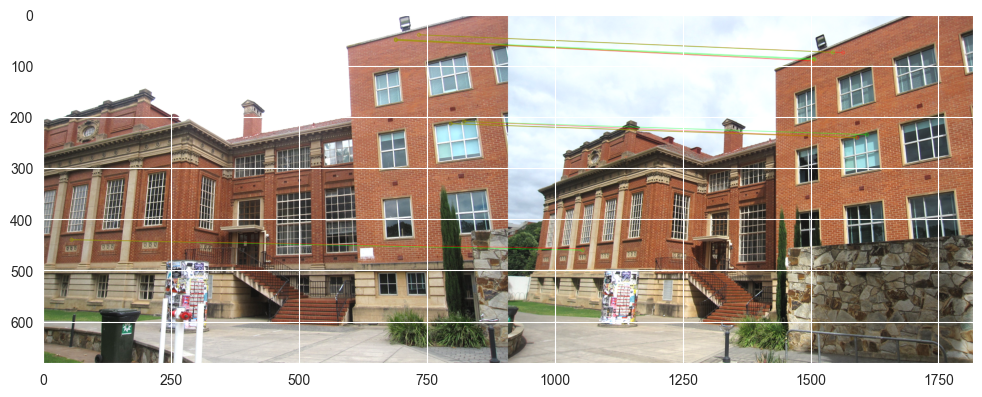

21.0 inliers found
the total number of point is:  23
The indexes of outlier points are: [24, 26]


<Figure size 640x480 with 0 Axes>

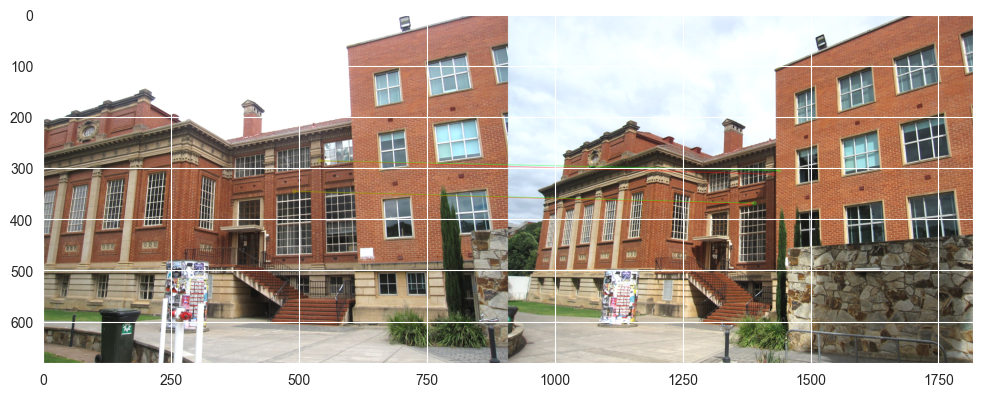

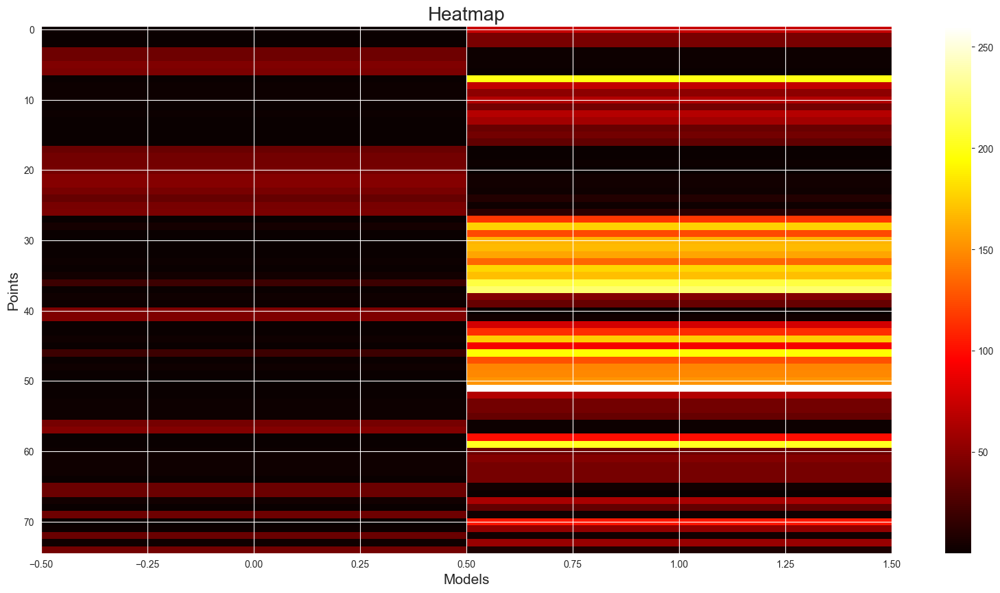

43.0 inliers found
the total number of point is:  58
The indexes of outlier points are: [0, 1, 2, 8, 9, 10, 14, 27, 32, 33, 37, 40, 44, 47, 51]


<Figure size 640x480 with 0 Axes>

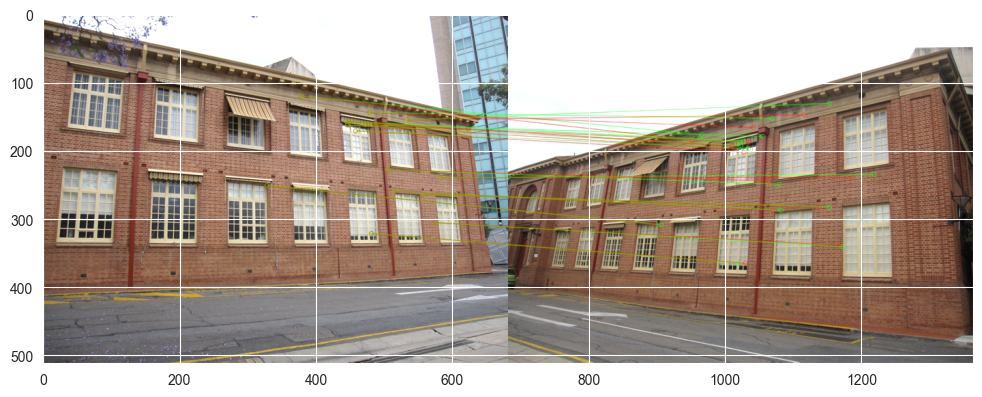

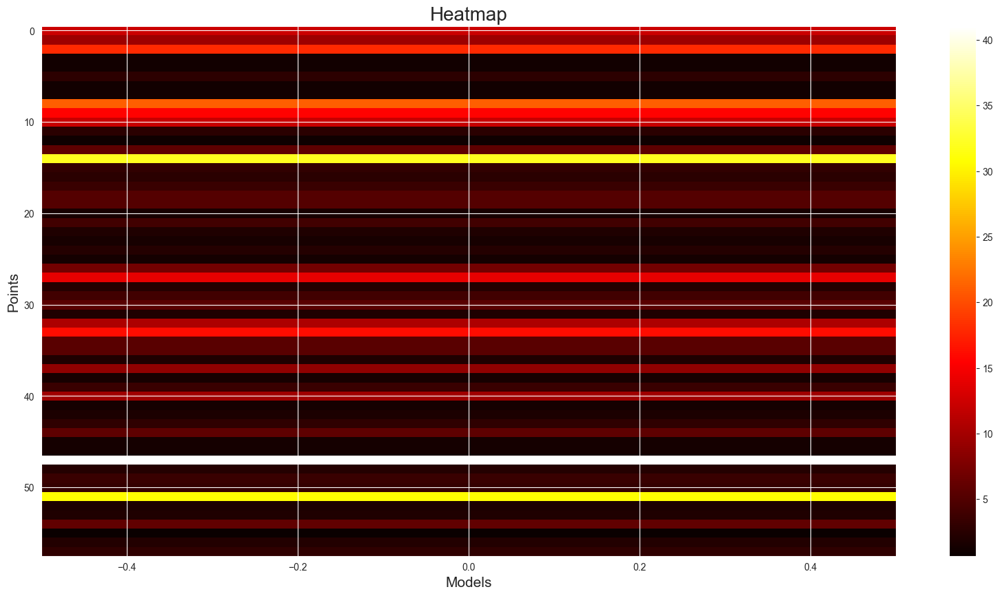

178.0 inliers found
the total number of point is:  185
The indexes of outlier points are: [14, 173, 177, 184, 192, 212, 255]


<Figure size 640x480 with 0 Axes>

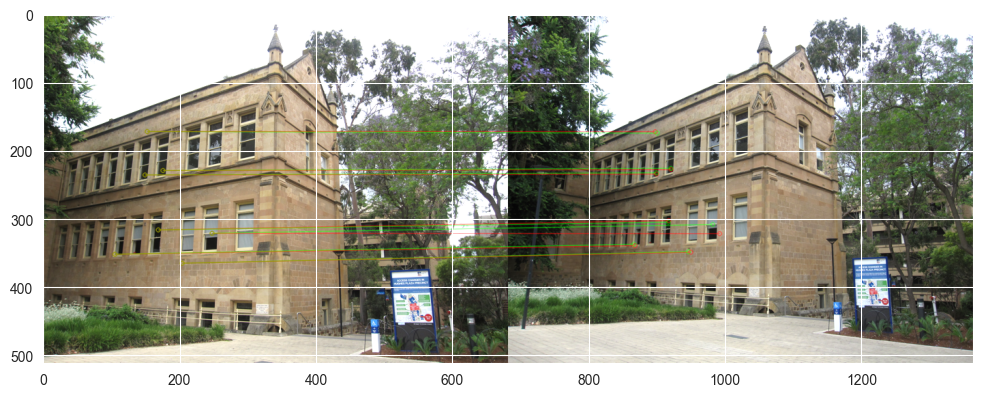

49.0 inliers found
the total number of point is:  71
The indexes of outlier points are: [25, 26, 27, 28, 29, 28, 29, 30, 31, 45, 56, 112, 155, 156, 157, 160, 161, 197, 201, 202, 238, 248, 249, 253]


<Figure size 640x480 with 0 Axes>

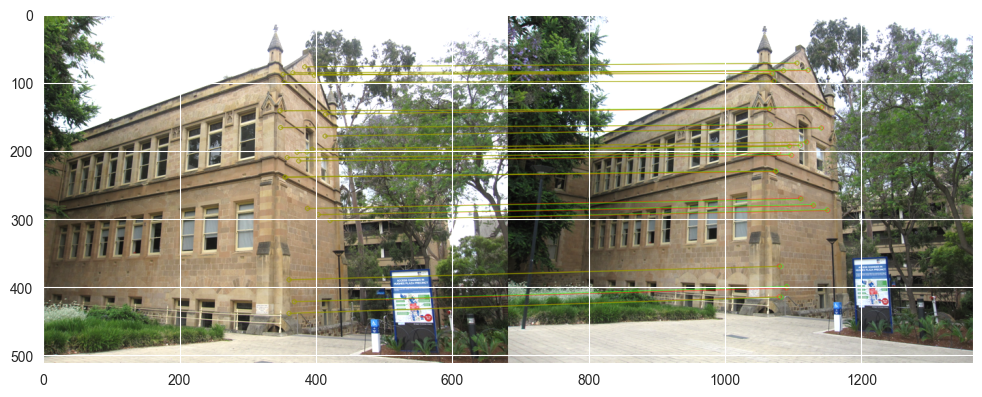

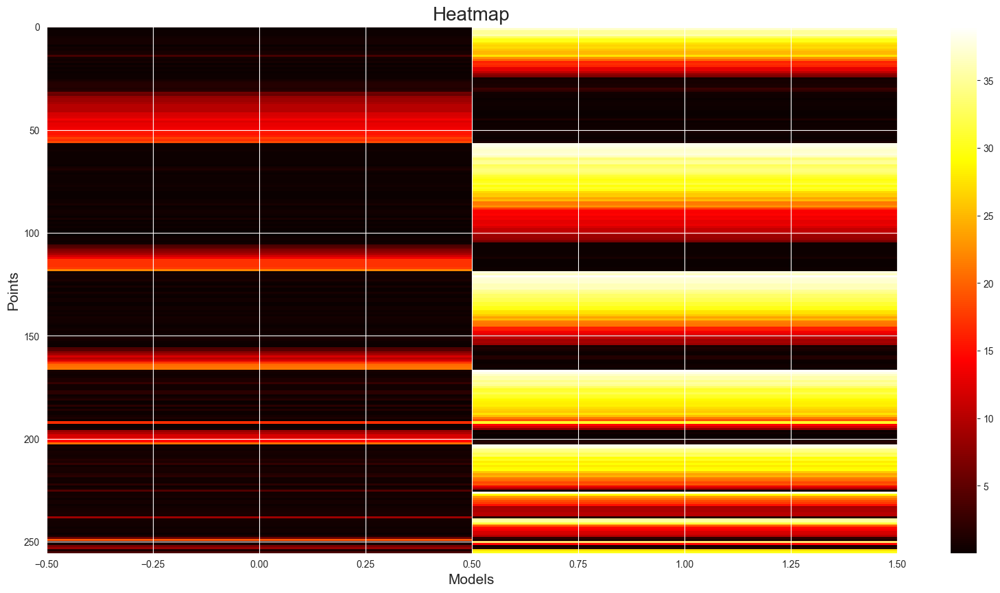

40.0 inliers found
the total number of point is:  50
The indexes of outlier points are: [0, 23, 29, 52, 54, 73, 74, 73, 74, 78, 85, 92]


<Figure size 640x480 with 0 Axes>

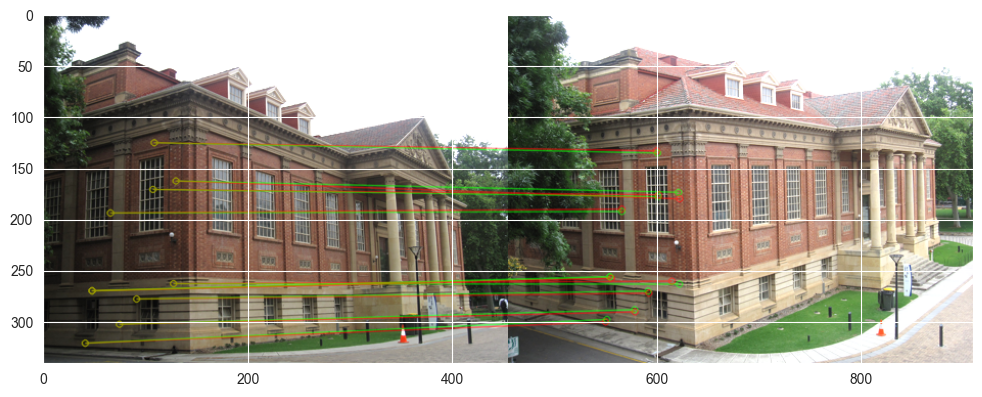

31.0 inliers found
the total number of point is:  46
The indexes of outlier points are: [4, 5, 7, 8, 17, 18, 20, 40, 56, 58, 83, 88, 89, 88, 89, 93, 95]


<Figure size 640x480 with 0 Axes>

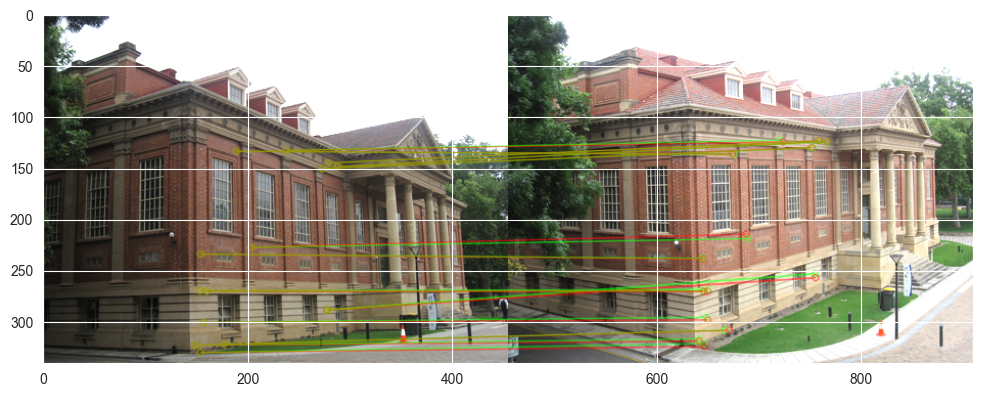

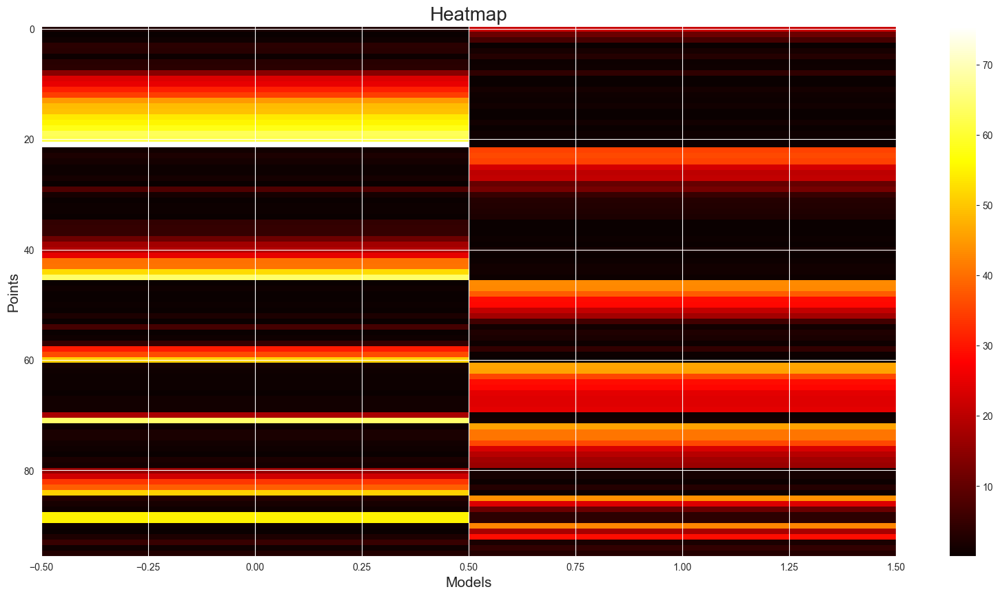

89.0 inliers found
the total number of point is:  105
The indexes of outlier points are: [1, 2, 21, 32, 37, 49, 68, 71, 78, 79, 80, 83, 94, 99, 103, 104]


<Figure size 640x480 with 0 Axes>

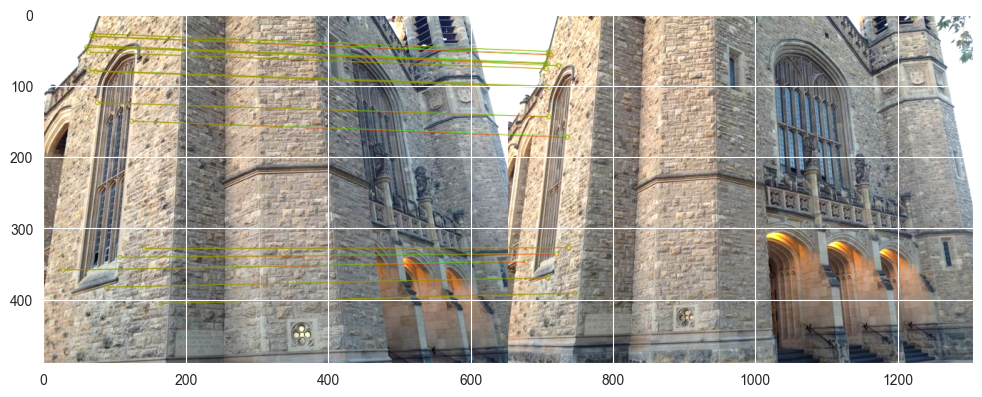

263.0 inliers found
the total number of point is:  304
The indexes of outlier points are: [120, 138, 142, 143, 142, 143, 144, 145, 144, 145, 152, 154, 157, 158, 157, 158, 159, 161, 164, 165, 169, 170, 183, 197, 202, 205, 210, 212, 232, 242, 245, 267, 268, 267, 268, 281, 282, 286, 291, 370, 320, 322, 336, 291, 370, 372, 383, 387, 390, 391, 396]


<Figure size 640x480 with 0 Axes>

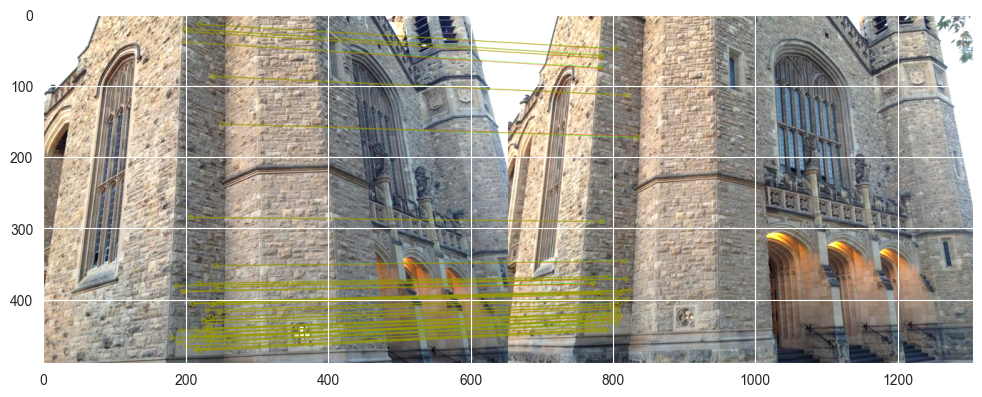

39.0 inliers found
the total number of point is:  61
The indexes of outlier points are: [409, 418, 421, 424, 427, 428, 427, 428, 429, 432, 434, 435, 442, 443, 446, 447, 448, 451, 453, 456, 462, 463, 465, 469]


<Figure size 640x480 with 0 Axes>

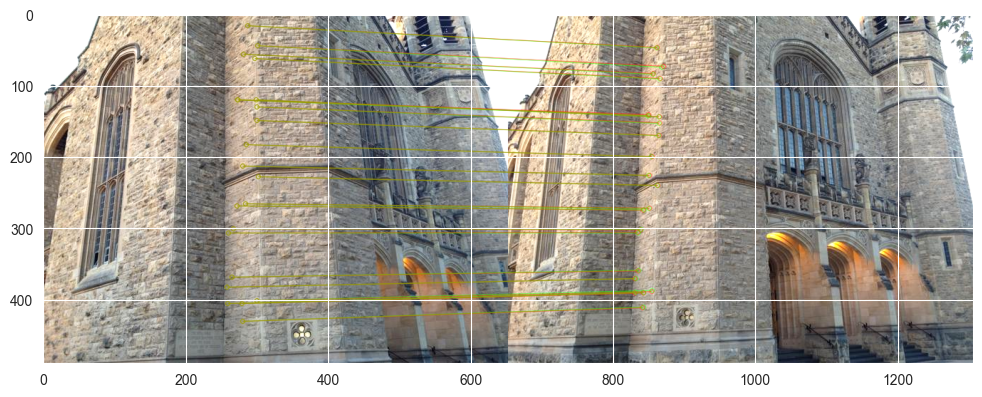

287.0 inliers found
the total number of point is:  339
The indexes of outlier points are: [474, 476, 477, 502, 505, 509, 547, 549, 550, 709, 551, 567, 579, 584, 585, 597, 598, 599, 600, 602, 604, 605, 604, 605, 606, 608, 610, 619, 625, 645, 661, 662, 666, 671, 673, 676, 677, 676, 677, 704, 550, 709, 727, 729, 730, 729, 730, 732, 733, 732, 733, 734, 735, 734, 735, 743, 744, 743, 744, 746, 759, 767, 774, 776, 777, 776, 777, 794]


<Figure size 640x480 with 0 Axes>

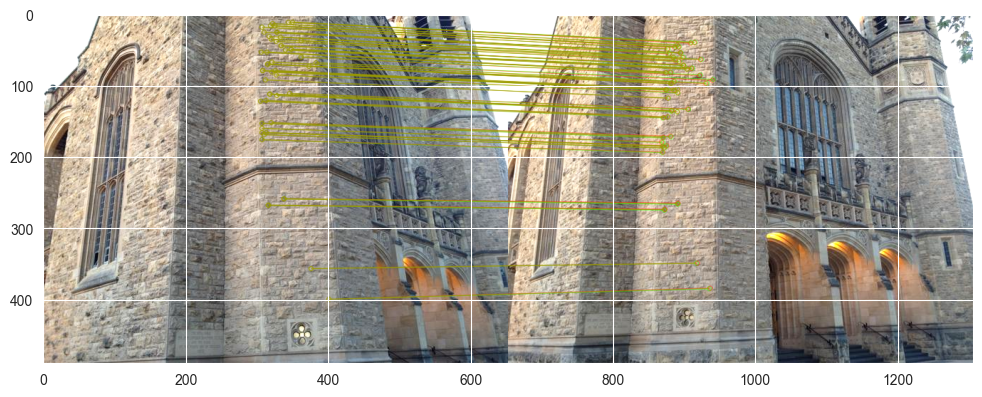

61.0 inliers found
the total number of point is:  77
The indexes of outlier points are: [809, 813, 815, 821, 830, 867, 843, 844, 843, 844, 845, 863, 864, 830, 867, 868, 869, 868, 869, 870, 879, 883]


<Figure size 640x480 with 0 Axes>

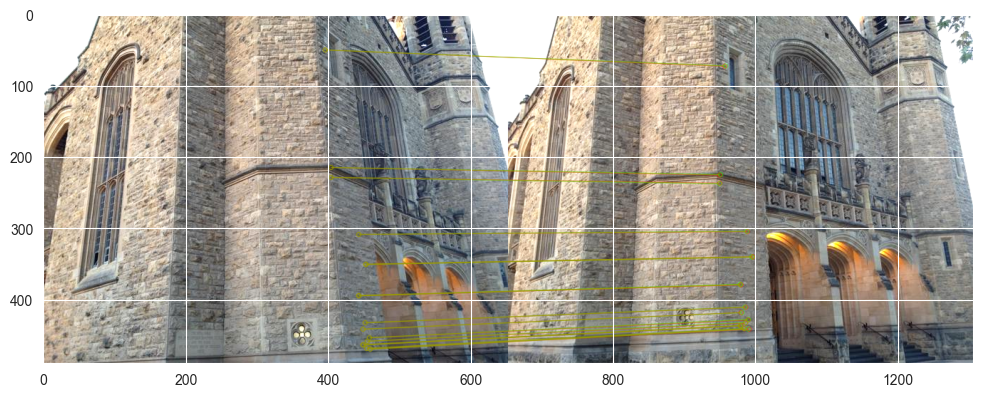

91.0 inliers found
the total number of point is:  116
The indexes of outlier points are: [893, 896, 897, 898, 901, 908, 911, 913, 914, 913, 914, 919, 921, 925, 926, 927, 931, 941, 942, 943, 942, 943, 951, 967, 968, 972, 991, 994, 997]


<Figure size 640x480 with 0 Axes>

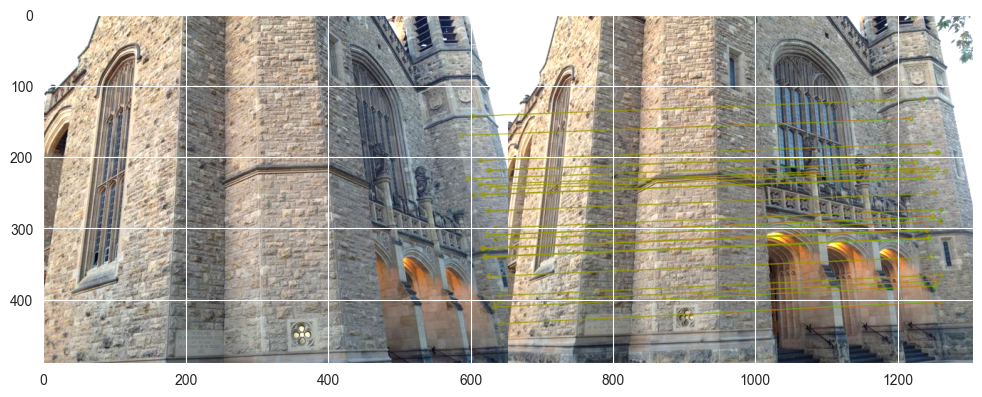

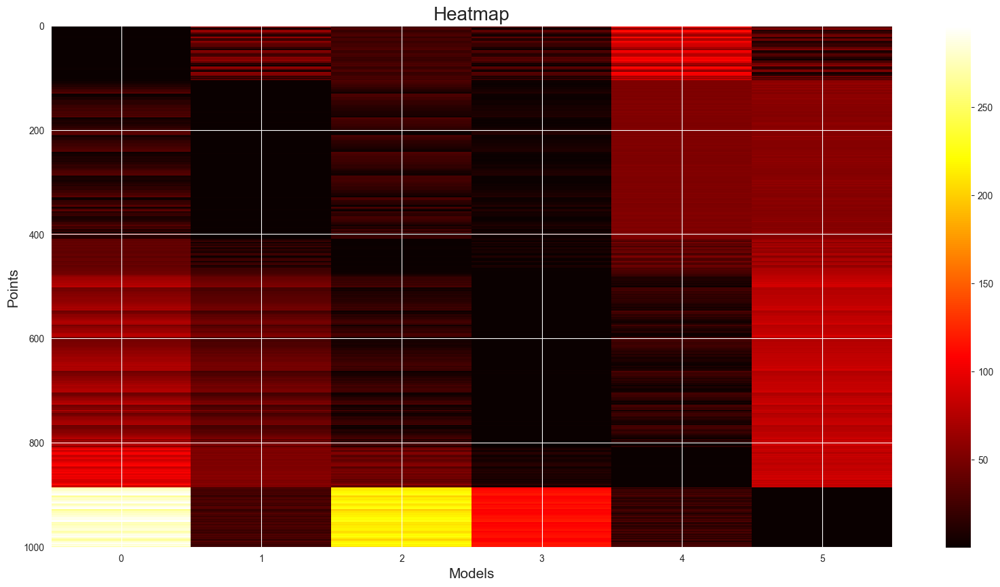

350.0 inliers found
the total number of point is:  500
The indexes of outlier points are: [19, 22, 32, 33, 34, 45, 46, 47, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 71, 79, 84, 98, 102, 103, 104, 103, 104, 105, 109, 115, 118, 121, 122, 123, 124, 127, 128, 129, 128, 129, 132, 137, 140, 141, 142, 143, 144, 145, 154, 155, 166, 171, 173, 176, 178, 183, 184, 185, 184, 185, 186, 189, 191, 406, 192, 193, 192, 193, 194, 409, 195, 196, 197, 198, 199, 200, 201, 212, 215, 219, 224, 225, 226, 228, 233, 234, 235, 236, 241, 243, 244, 245, 246, 248, 251, 253, 254, 255, 258, 268, 272, 273, 275, 276, 277, 278, 284, 285, 288, 290, 291, 292, 293, 294, 295, 296, 297, 335, 298, 299, 300, 303, 313, 316, 317, 320, 321, 320, 321, 325, 329, 330, 331, 330, 331, 332, 333, 334, 333, 334, 297, 335, 402, 191, 406, 194, 409, 411, 413, 414, 417, 418, 419, 420, 421, 423, 424, 437, 459, 466]


<Figure size 640x480 with 0 Axes>

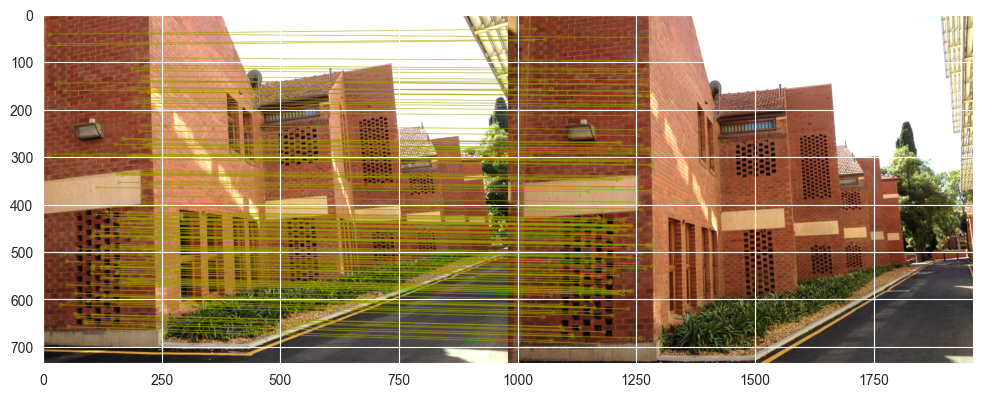

62.0 inliers found
the total number of point is:  87
The indexes of outlier points are: [500, 501, 587, 502, 588, 503, 504, 506, 604, 508, 512, 518, 523, 520, 738, 521, 518, 523, 527, 531, 532, 533, 534, 544, 555, 976, 564, 568, 581, 572, 579, 568, 581, 585]


<Figure size 640x480 with 0 Axes>

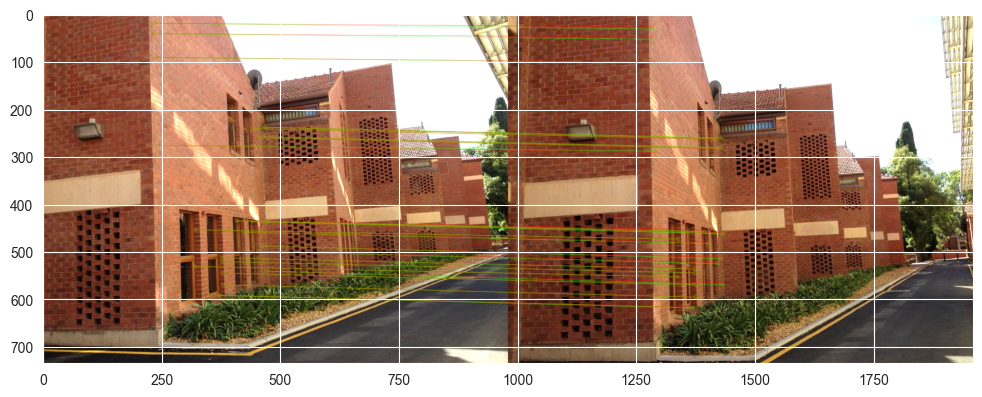

495.0 inliers found
the total number of point is:  496
The indexes of outlier points are: [744]


<Figure size 640x480 with 0 Axes>

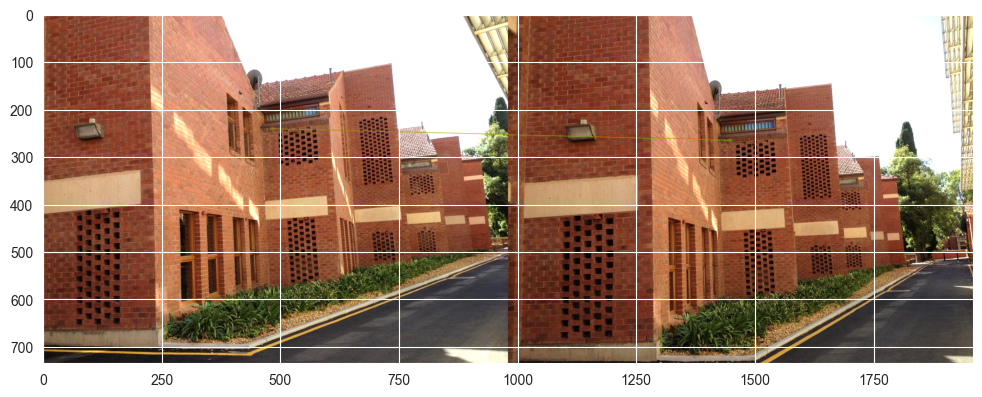

434.0 inliers found
the total number of point is:  500
The indexes of outlier points are: [1084, 1085, 1087, 1088, 1087, 1088, 1092, 1116, 1132, 1144, 1145, 1144, 1145, 1146, 1150, 1153, 1155, 1156, 1163, 1166, 1168, 1169, 1170, 1171, 1172, 1171, 1172, 1173, 1176, 1177, 1186, 1191, 1192, 1191, 1192, 1225, 1243, 1250, 1251, 1253, 1254, 1255, 1254, 1255, 1278, 1290, 1291, 1290, 1291, 1309, 1318, 1330, 1352, 1353, 1354, 1352, 1353, 1354, 1352, 1353, 1354, 1356, 1361, 1368, 1369, 1370, 1412, 1426, 1432, 1454, 1468, 1483, 1498, 1511, 1517, 1518, 1519, 1518, 1519, 1521, 1535, 1543, 1560, 1561, 1560, 1561, 1562, 1574]


<Figure size 640x480 with 0 Axes>

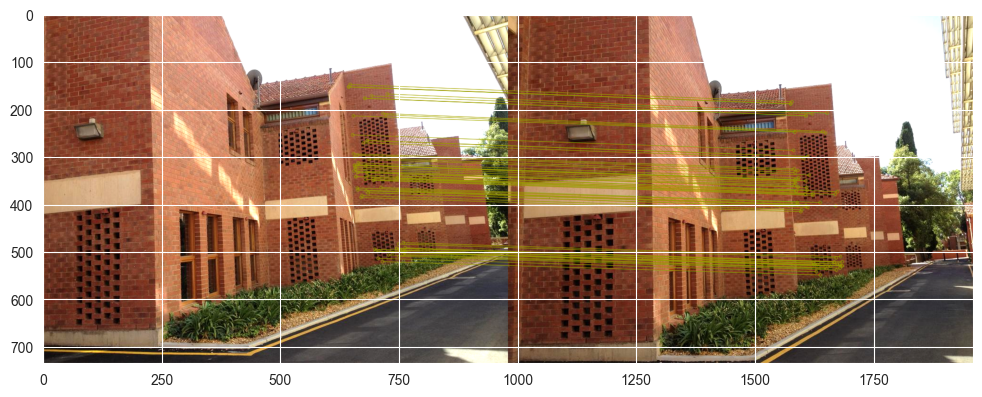

135.0 inliers found
the total number of point is:  156
The indexes of outlier points are: [1592, 1601, 1603, 1604, 1603, 1604, 1616, 1627, 1646, 1648, 1649, 1648, 1649, 1650, 1651, 1650, 1651, 1669, 1681, 1689, 1690, 1689, 1690, 1699, 1700, 1711, 1712, 1711, 1712, 1721, 1738]


<Figure size 640x480 with 0 Axes>

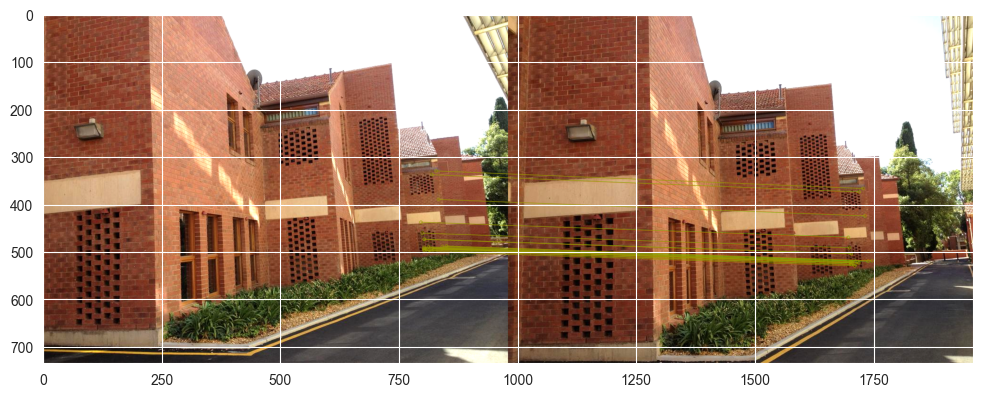

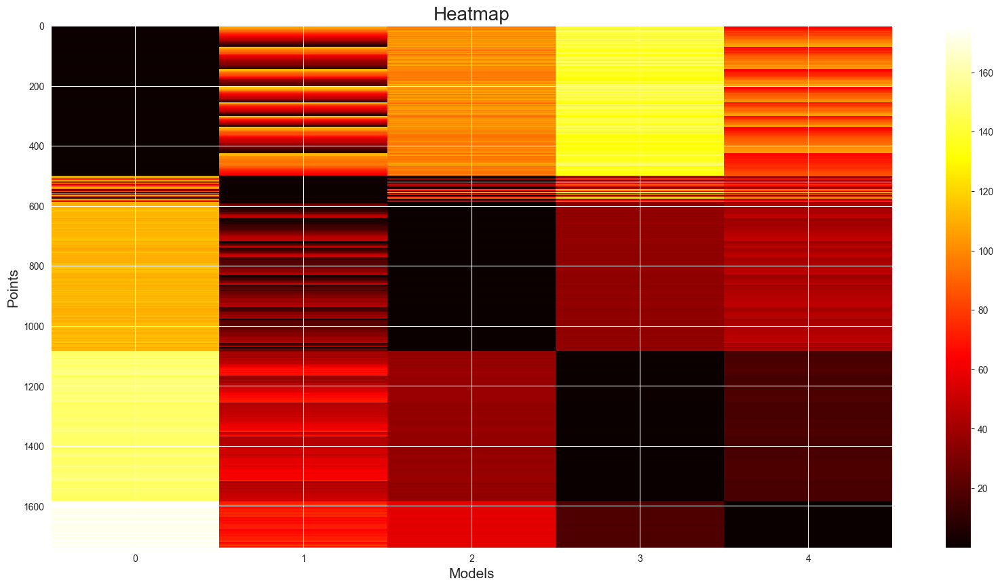

34.0 inliers found
the total number of point is:  38
The indexes of outlier points are: [43, 47, 81, 82]


<Figure size 640x480 with 0 Axes>

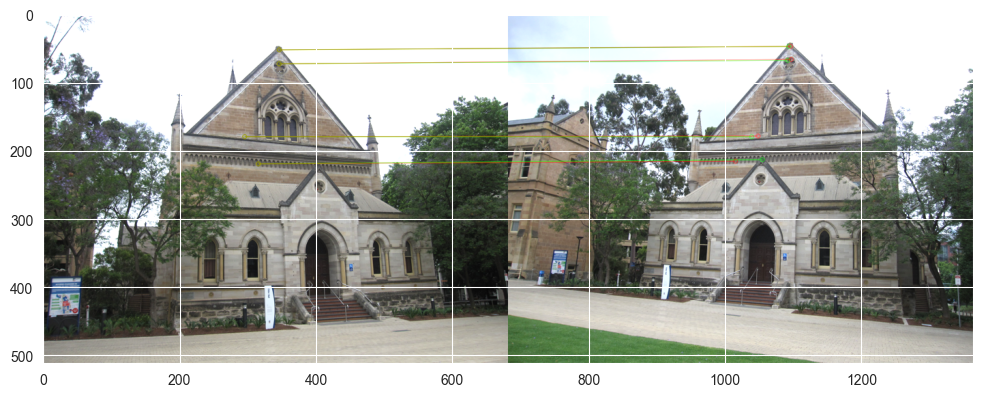

27.0 inliers found
the total number of point is:  46
The indexes of outlier points are: [15, 17, 18, 19, 20, 22, 23, 32, 41, 42, 57, 68, 72, 73, 74, 75, 76, 79, 80]


<Figure size 640x480 with 0 Axes>

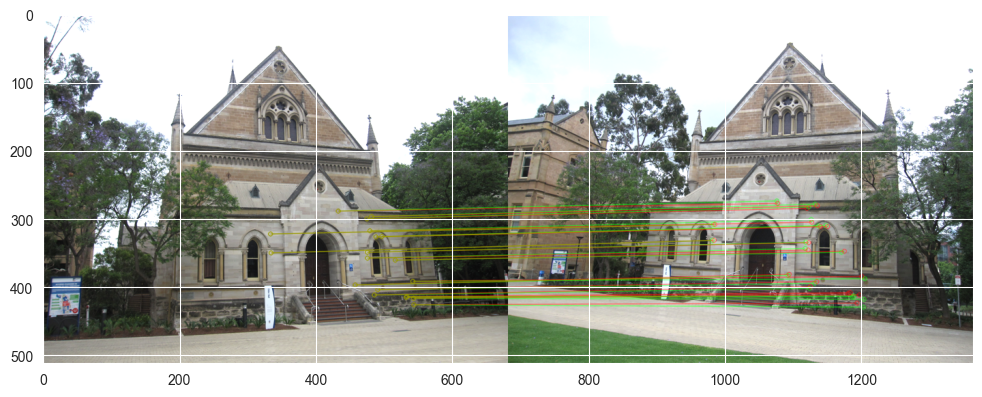

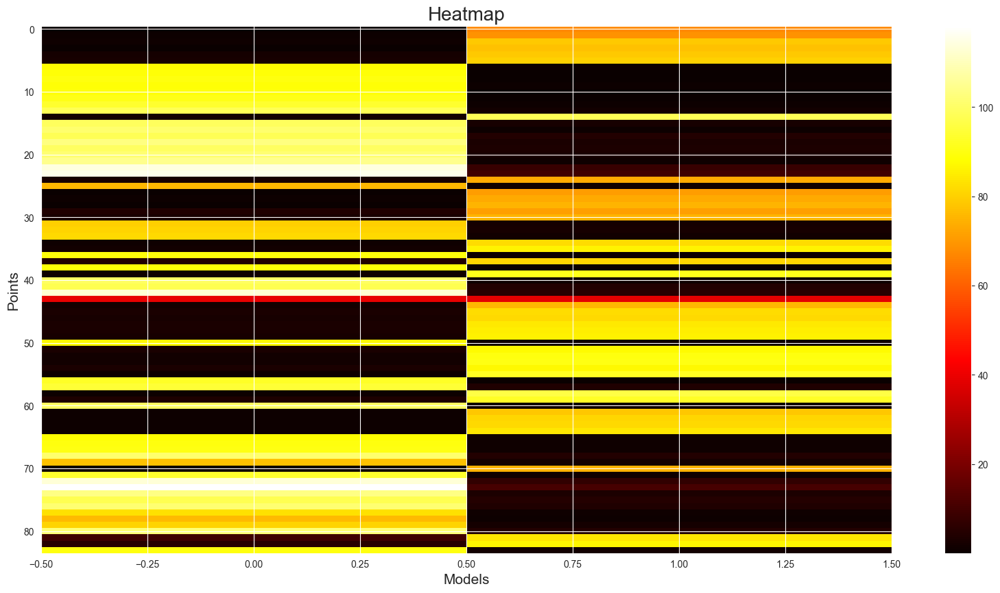

38.0 inliers found
the total number of point is:  42
The indexes of outlier points are: [67, 72, 74, 80]


<Figure size 640x480 with 0 Axes>

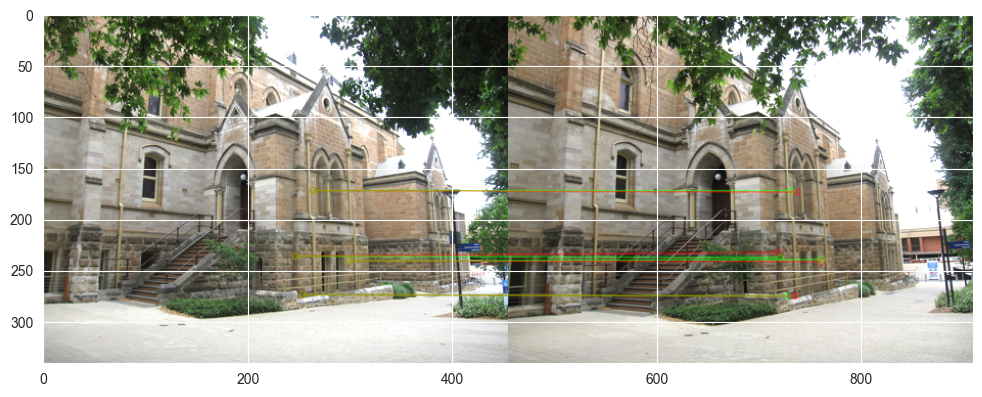

22.0 inliers found
the total number of point is:  28
The indexes of outlier points are: [33, 64, 92, 128, 129, 132]


<Figure size 640x480 with 0 Axes>

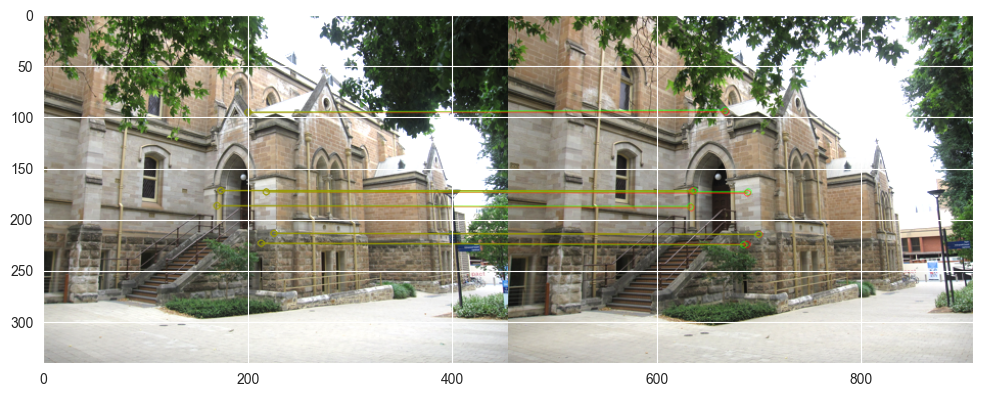

49.0 inliers found
the total number of point is:  63
The indexes of outlier points are: [1, 4, 12, 20, 49, 52, 81, 82, 83, 85, 118, 119, 126, 131]


<Figure size 640x480 with 0 Axes>

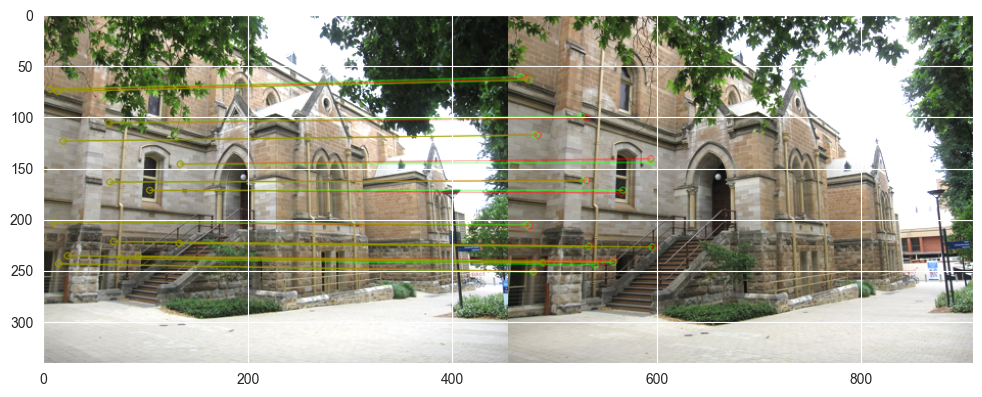

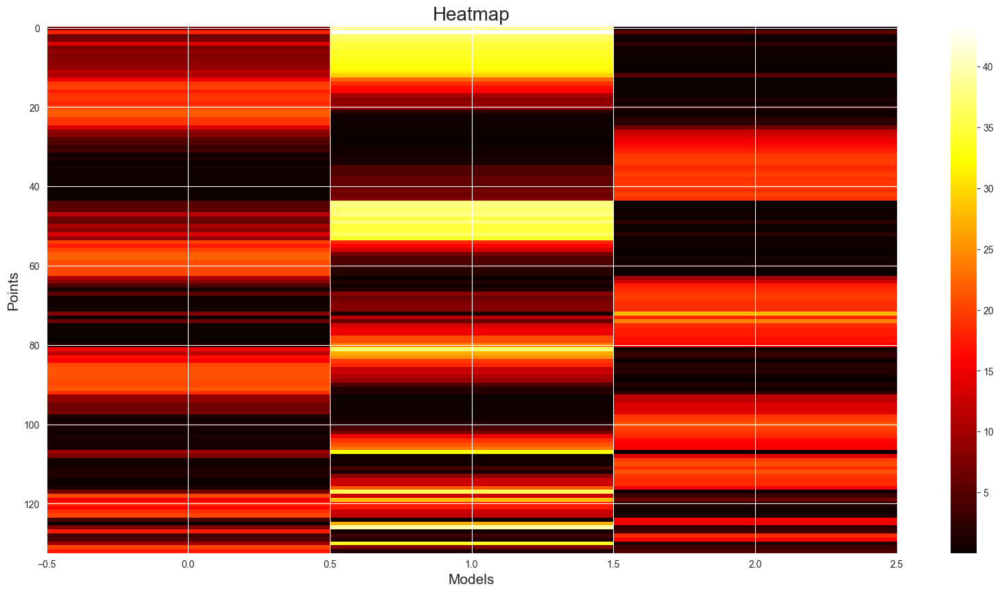

16.0 inliers found
the total number of point is:  20
The indexes of outlier points are: [304, 305, 304, 305, 455, 457]


<Figure size 640x480 with 0 Axes>

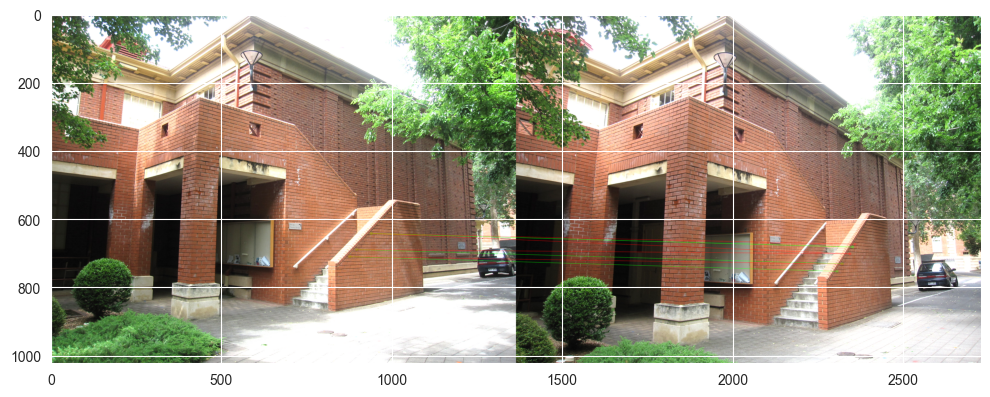

58.0 inliers found
the total number of point is:  77
The indexes of outlier points are: [136, 143, 173, 312, 313, 312, 313, 314, 423, 425, 447, 462, 495, 496, 515, 527, 534, 551, 560, 565, 568]


<Figure size 640x480 with 0 Axes>

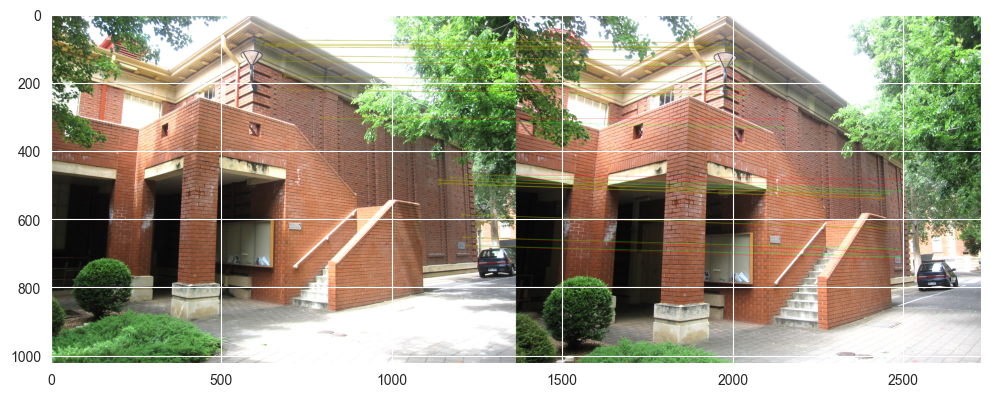

246.0 inliers found
the total number of point is:  291
The indexes of outlier points are: [76, 79, 85, 88, 90, 91, 92, 93, 92, 93, 95, 98, 99, 98, 99, 104, 116, 198, 207, 356, 358, 361, 362, 366, 367, 369, 370, 371, 372, 375, 377, 380, 381, 387, 391, 393, 442, 473, 474, 475, 476, 477, 478, 506, 507, 523, 549, 559, 569]


<Figure size 640x480 with 0 Axes>

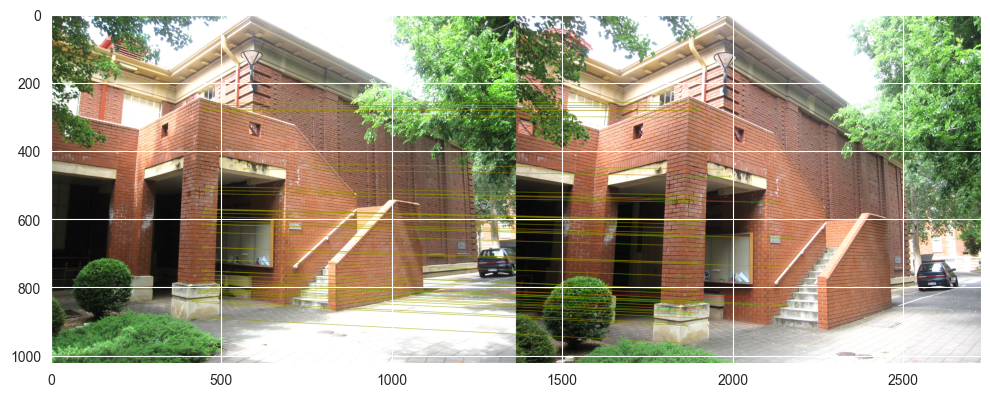

49.0 inliers found
the total number of point is:  69
The indexes of outlier points are: [63, 64, 72, 73, 72, 73, 77, 78, 77, 78, 82, 83, 82, 83, 86, 87, 334, 338, 468, 519, 520, 547, 553, 554, 557, 563]


<Figure size 640x480 with 0 Axes>

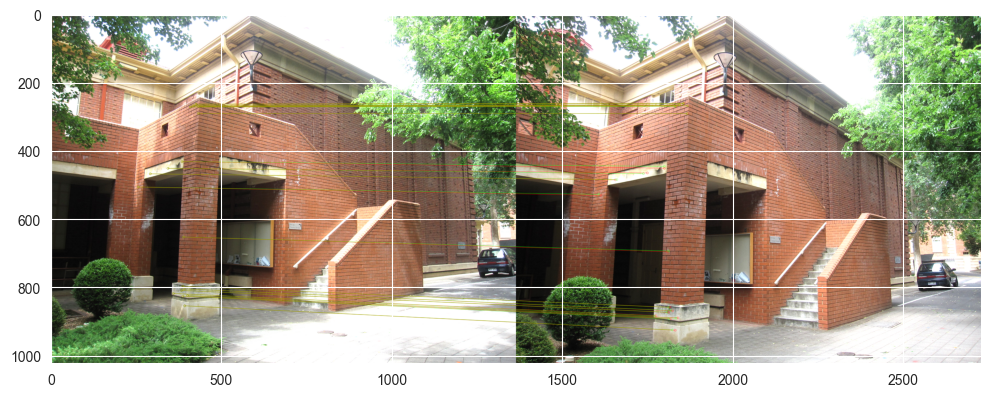

25.0 inliers found
the total number of point is:  41
The indexes of outlier points are: [117, 118, 119, 120, 123, 126, 129, 403, 416, 419, 420, 482, 509, 524, 536, 537]


<Figure size 640x480 with 0 Axes>

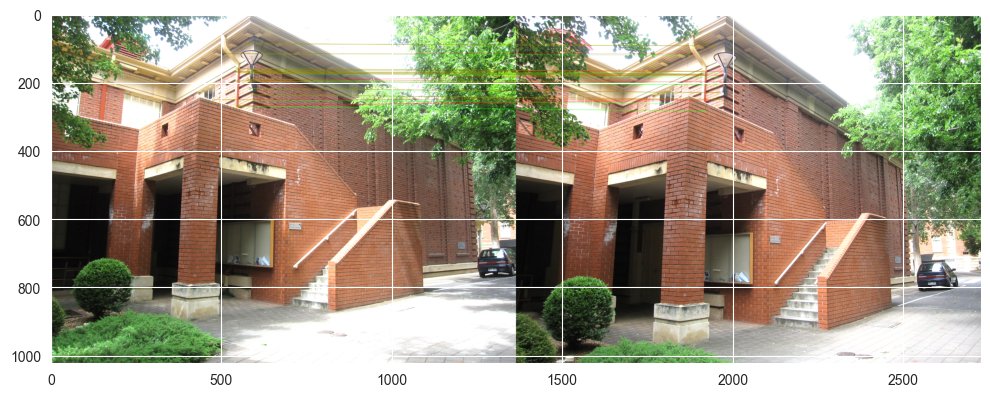

15.0 inliers found
the total number of point is:  15
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

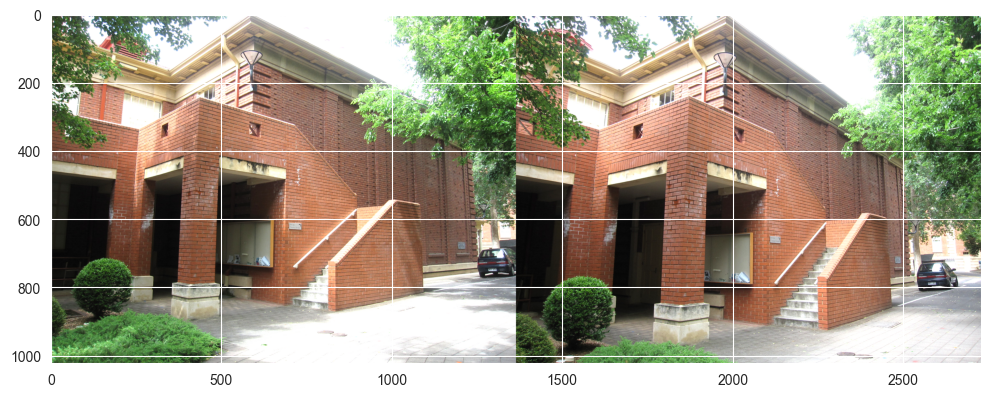

51.0 inliers found
the total number of point is:  58
The indexes of outlier points are: [2, 23, 30, 466, 500, 567, 570]


<Figure size 640x480 with 0 Axes>

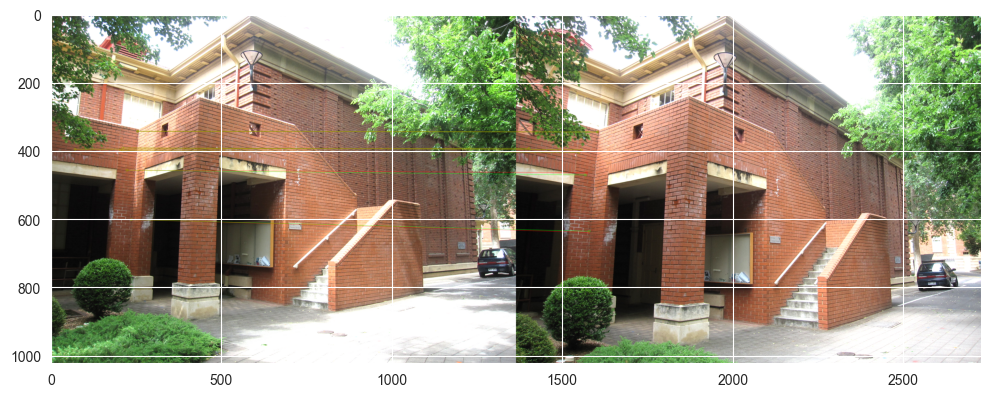

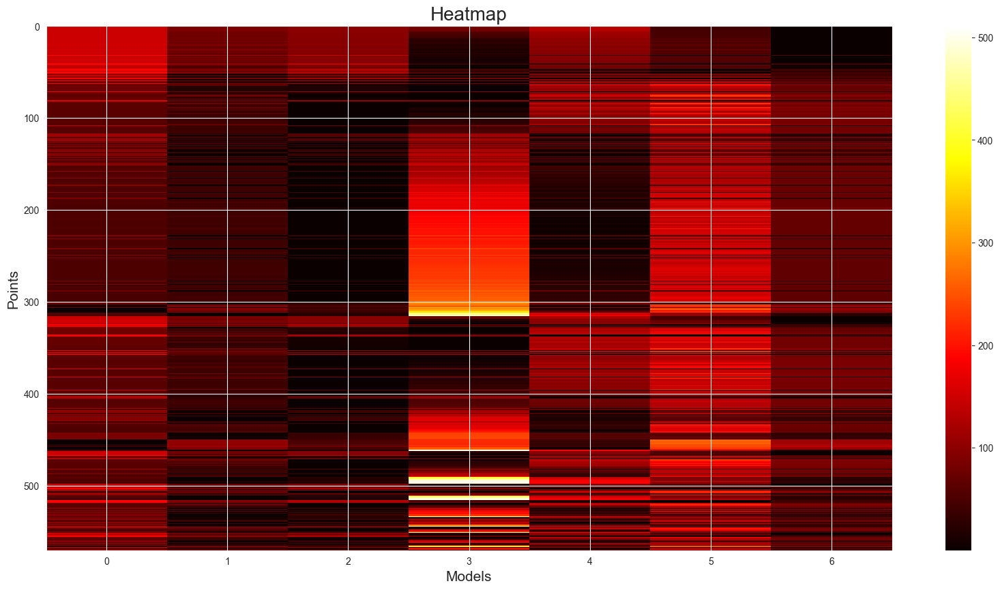

70.0 inliers found
the total number of point is:  86
The indexes of outlier points are: [3, 6, 20, 21, 41, 44, 49, 51, 62, 94, 101, 120, 121, 123, 128, 130]


<Figure size 640x480 with 0 Axes>

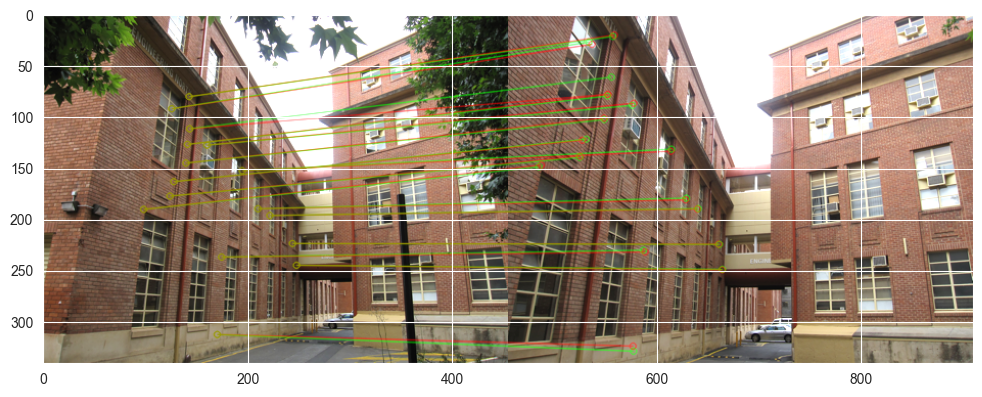

42.0 inliers found
the total number of point is:  46
The indexes of outlier points are: [39, 107, 129, 131]


<Figure size 640x480 with 0 Axes>

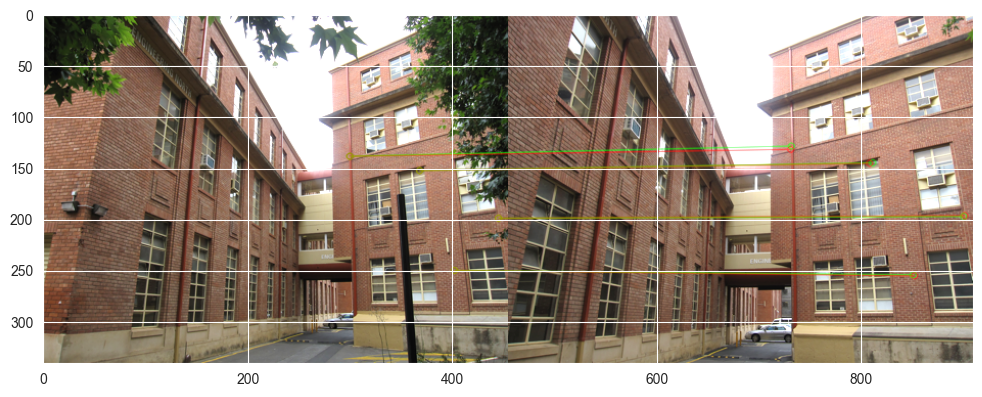

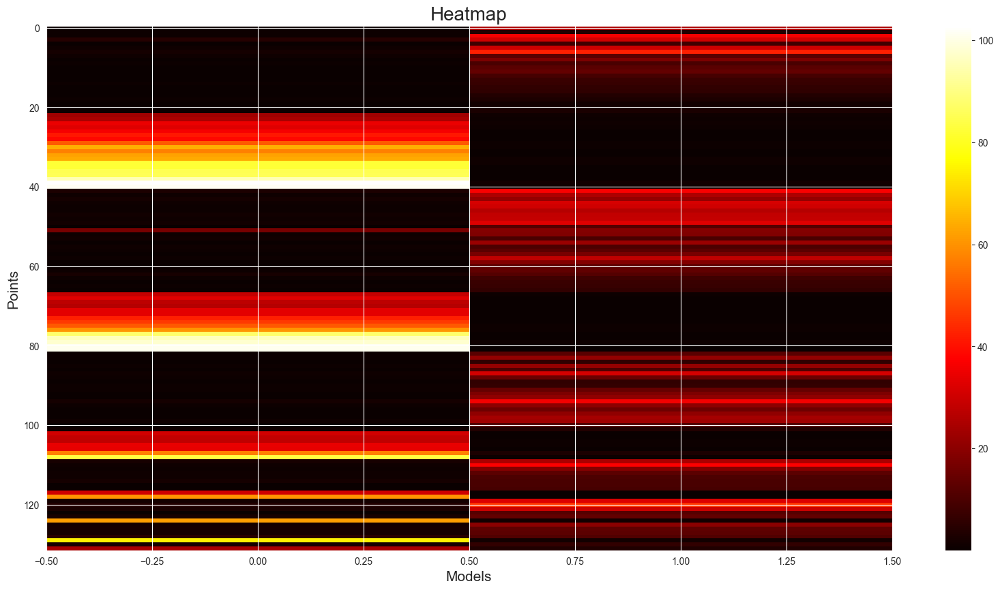

In [25]:
number_of_data_to_analyse=10
plot_heat=True

for i in range(number_of_data_to_analyse):
    data=mat_data[names[i]]
    res=build_residual_matrix(data, plot=True, method='ransac', threshold=thresholds[i])

    if plot_heat:
        plt.figure(figsize=(20, 10))  # Adjust figure size here
        plt.imshow(res, cmap='hot', interpolation='nearest', aspect="auto")
        #cbar = plt.colorbar()  # Add colorbar to show values
        plt.colorbar().ax.tick_params(labelsize=10)  # Adjust colorbar label size
        plt.title('Heatmap', fontsize=20)  # Adjust title font size
        plt.xlabel('Models', fontsize=15)  # Adjust x-axis label font size
        plt.ylabel('Points', fontsize=15)  # Adjust y-axis label font size
        plt.show()